# 数值计算方法

2024 年秋季学期本科

## 第 7 章 微分方程数值解

### 引言

在现实生活中，微分方程广泛应用于各种科学、工程和经济领域中，描述各种物理、化学、生物和经济系统的动态行为. 由于很多微分方程没有精确解或解析解非常复杂，数值方法因此变得尤为重要

- **人口模型 (ODE)** - 用于模拟生物种群增长，如Logistic模型
- **流体动力学 (PDE)** - Navier-Stokes方程用于模拟气体和液体的流动，应用于气象学和航空航天
- **量子力学 (PDE)** - Schrödinger方程描述量子粒子的波函数，用于现代物理学
- **化学反应动力学 (ODE组)** - 模拟化学反应中的浓度变化，重要于化学工程和制药业
- **弹性力学 (PDE组)** - 用于描述物体在力作用下的应力和形变，关键于建筑和材料科学
- **金融数学中的期权定价 (SDE)** - Black-Scholes方程及其随机版本用于金融衍生品定价

**摆** (pendulum) 的运动可以用下述二阶微分方程描写 $$\frac{{\rm{d}}^2\theta}{{\rm{d}} t^2}+\frac{g}{L}\sin\theta=0$$ 其中

- $t$ 是时间
- $L$ 是摆长
- $g$ 是重力加速度
- $\theta$ 是摆与垂向的夹角

如果再假设开始摆动的时刻是 $t_0$，在这个时刻摆的位置是 $\theta(t_0)=\theta_0$，摆的速度是 $\theta^\prime(t_0)=\theta^\prime_0$，这就构成一个初值问题.

<img src="./assets/simple_gravity_pendulum.png" width="320" style="display: block;margin-left: auto;margin-right: auto;" />

对于较小的夹角，我们有近似 $\theta\approx\sin\theta$，因此问题化简为线性的**简谐运动** (simple harmonic motion). $$\frac{{\rm{d}}^2\theta}{{\rm{d}} t^2}+\frac{g}{L}\theta=0,\quad\theta(t_0)=\theta_0,\quad\theta^\prime(t_0)=\theta^\prime_0$$

这个问题可以用数学分析中介绍的方法求解. 其解析解是 $$\theta(t)=\theta_0\cos\left(\frac{2\pi}{T}(t-t_0)+\phi\right)$$ 其中 $$\phi=\arcsin\left(-\frac{\theta_0^\prime T}{\theta_02\pi}\right),\quad T=2\pi\sqrt{\frac{L}{g}}$$

但是，对于较大的夹角，假设 $\theta\approx\sin\theta$ 就不再合理，就必须用**近似方法**求解.

### 微分方程

微分方程通常涉及一个变量相对于另一个变量的变化. 

形如 $$\frac{{\rm{d}} y}{{\rm{d}} t}=y^\prime=f(t,y),\quad a\le t \le b$$ 的方程是一阶微分方程，其初始条件是 $$y(a)=\alpha_0$$ 

形如 $$y^{(n)}=f(t,y,y^\prime,y^{\prime\prime},\dots, y^{(n-1)}),\quad a\le t \le b$$ 的方程是 $n$ 阶微分方程，其初始条件为 $$y(a)=\alpha_1,\;y^\prime(a)=\alpha_2,\;\dots,\;y^{(n-1)}(a)=\alpha_n$$

寻找给定初始条件的解，就是初值问题.

> 一个函数 $f(t,y)$ 在集合 $D\subset \mathbb{R}^2$ 上关于变量 $y$ 满足 Lipschitz 条件，若存在一个常数 $L>0$，只要 $(t,y_1)$ 和 $(t,y_2)$ 在集合 $D$ 内，就满足 $$|f(t,y_1)-f(t,y_2)|\le L|y_1-y_2|$$ 常数 $L$ 称为 **Lipschitz 常数** (Lipschitz constant).

下面的定理给出了一阶微分方程解的存在性和唯一性.

> 假设 $D=\{(t,y)|a\le t\le b,-\infty<y<\infty\}$ 且 $f(t,y)$ 在 $D$ 上连续. 如果 $f$ 在 $D$ 上关于 $y$ 满足 Lipschitz 条件，则初值问题 $$y(t)=f(t,y),\quad a\le t\le b,\quad y(a)=\alpha$$ 有唯一解.

#### 一阶微分方程组

我们已经看到单一变量如何随时间演变的模型. 然而在许多实际应用中，系统的行为依赖于多个相互连接的变量. 多元一阶线性方程组可以描述这些变量的动态关系，提供更全面的系统分析和预测能力.

一个 **m 元一阶线性方程组** ($m$th-order system of first-order) 具有如下形式
$$\begin{align*}
&\frac{{\rm{d}} u_1}{{\rm{d}} t}=f_1(t,u_1,u_2,\dots,u_m)\\
&\frac{{\rm{d}} u_2}{{\rm{d}} t}=f_2(t,u_1,u_2,\dots,u_m)\\
&\dots\\
&\frac{{\rm{d}} u_m}{{\rm{d}} t}=f_m(t,u_1,u_2,\dots,u_m)
\end{align*}$$
对于 $a\le t\le b$，初始条件为 $$u_1(a)=\alpha_1,\quad u_2(a)=\alpha_2,\quad \dots,\quad u_m(a)=\alpha_m$$

目标是找到 $m$ 个函数 $u_1(t),u_2(t),\dots,u_m(t)$，满足每个微分方程和所有初始条件.

#### 高阶方程

高于一阶的微分方程初值问题，通过变量重命名可以转化为一阶微分方程组.

今有 $m$ 阶常微分方程初值问题 $$y^{(m)}(t) = f(t,y,y^\prime,...,y^{(m-1)}),\quad a \le t \le b$$ 其初始条件 $y(a) = \alpha_1,y^\prime(a) = \alpha_2, \dots，y^{(m-1)}(a)=\alpha_m$ 

可以转化为前面讨论的一阶微分方程组.
令 $u_1(t)=y(t),u_2(t)=y^\prime(t),\dots,u_m(t)=y^{(m-1)}(t)$. 这就产生了一阶方程组 $$\frac{{\rm{d}} u_1}{{\rm{d}} t}=\frac{{\rm{d}} y}{{\rm{d}} t}=u_2,\frac{{\rm{d}} u_2}{{\rm{d}} t}=\frac{{\rm{d}} y^\prime}{{\rm{d}} t}=u_3,\dots,\frac{{\rm{d}} u_{m-1}}{{\rm{d}} t}=\frac{{\rm{d}} y^{(m-2)}}{{\rm{d}} t}=u_m$$ 和 $$\frac{{\rm{d}} u_m}{{\rm{d}} t}=\frac{{\rm{d}} y^{(m-1)}}{{\rm{d}} t}=f(t,y,y^\prime,...,y^{(m-1)})=f(t,u_1,u_2,\dots,u_m)$$ 及其初始条件 $$u_1(a)=y(a)=\alpha_1,u_2(a)=y^\prime(a)=\alpha_2,\dots,u_m(a)=y^{(m-1)}(a)=\alpha_m$$

#### 定解条件

我们已经讨论了只需要在一个初始点设定条件的一阶微分方程，这类问题称为初值问题. 然而，如果一个微分方程需要在多个特定点设定条件，面对的则是边值问题. 初值问题主要关注时间演进的系统，而边值问题则常见于空间变量的系统描述. 

对于一阶微分方程，只有一个条件被指定，所以初值问题和边值问题之间并无区别. 

边值问题在物理学中尤为常见，它们通常涉及在两个或多个不同位置施加条件。一个典型的例子是二阶微分方程的两点边值问题，形式如下：
$$y^{\prime\prime} = f(x, y, y^\prime), \quad a \leq x \leq b$$
并伴有以下边界条件：
$$y(a) = \alpha, \quad y(b) = \beta$$

这类问题的解决方案为我们提供了例如杆的弯曲、电子在电场中的行为等多种物理现象的模型.

### 数值微分

函数 $f$ 在 $x_0$ 处的**导数** (derivative) 是 $$f^\prime(x_0)=\lim_{h\to 0}\frac{f(x_0+h)-f(x_0)}{h}$$

我们很容易想到用差商 $$\frac{f(x_0+h)-f(x_0)}{h}$$ 去**近似逼近**导数 $f^\prime(x_0)$，但是这么做会有问题. 比如，仅对小的 $h$ 有效.

对于较小的 $h$ 值，差商 $\displaystyle\frac{f (x_0 + h) - f (x_0 )}{h}$ 可用于近似 $f^\prime(x_0)$，误差界为 $\displaystyle\frac{M|h|}{2}$，其中 $M$ 是位于 $x_0$ 和 $x_0 + h$ 之间的 $x$ 在 $|f^{\prime\prime}(x)|$ 上的界. 如果 $h > 0$，则该公式称为**向前差分公式** (forward-difference formula)，如果 $h < 0$，则称为**向后差分公式** (backward-difference formula).

> 【例 7.1】
>
> 使用向前差分公式，分别用 $h = 0.1$、$h = 0.05$ 和 $h = 0.01$ 来近似计算 $f(x) = \ln x$ 在 $x_0 = 1.8$ 处的导数，并确定近似误差的界.

注意到 $f^{\prime\prime}(x)=-\displaystyle\frac{1}{x^2}$，$\xi$ 介于 1.8 和 1.8+$h$ 之间，因而 $\xi>x_0$

|$$h$$  | $$f(x_0+h)$$ | $$\displaystyle\frac{f(x_0+h)-f(x_0)}{h}$$ | $$\displaystyle\frac{|hf^{\prime\prime}(\xi)|}{2}=\frac{|h|}{2\xi^2}<\frac{|h|}{2x_0^2}$$ |
|--|--|--|--|
|0.1  | 0.64185389 | 0.5406722                   | 0.0154321                                                                 |
|0.05 | 0.61518564 | 0.5479795                   | 0.0077160                                                                 |
|0.01 | 0.59332685 | 0.5540180                   | 0.0015432                                                                 |

由于 $f^\prime(x)=\displaystyle\frac{1}{x}$，因此导数在 $x_0=1.8$ 上的精确值是 $0.\overline{5}$

我们看到，**似乎** $h$ 越小，得到的近似值越接近精确值.

h         f(x0+h)             数值微分                误差界                 
0.5       0.83290912          0.49024492          0.07716049          
0.25      0.71783979          0.52021251          0.03858025          
0.1       0.64185389          0.54067221          0.01543210          
0.05      0.61518564          0.54797948          0.00771605          
0.01      0.59332685          0.55401804          0.00154321          
0.005     0.59056059          0.55478538          0.00077160          
0.001     0.58834207          0.55540129          0.00015432          


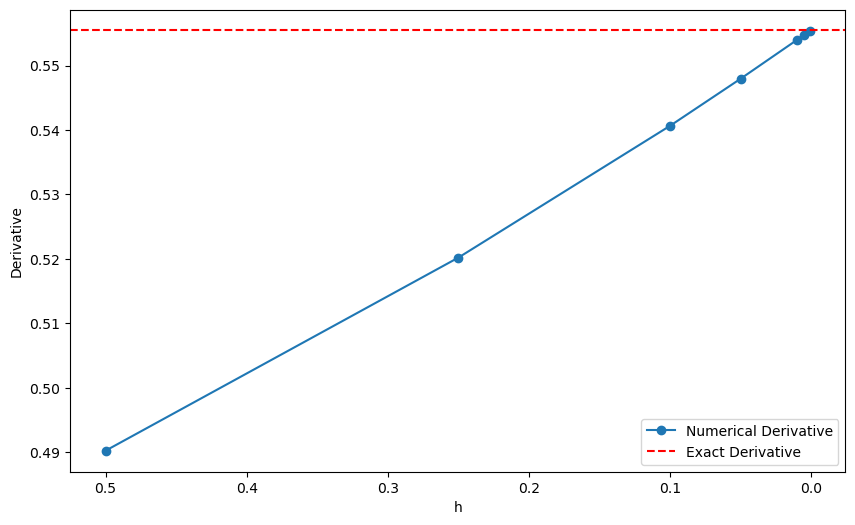

In [1]:
import numpy as np
import matplotlib.pyplot as plt

# 定义函数和其导数
def f(x):
    return np.log(x)

def f_prime_exact(x):
    return 1 / x

def forward_difference(f, x0, h):
    return (f(x0 + h) - f(x0)) / h

def second_derivative_bound(x0, h):
    return abs(h) / (2 * x0**2)

# 设置参数
x0 = 1.8
h_values = [0.5, 0.25, 0.1, 0.05, 0.01, 0.005, 0.001]
exact_derivative = f_prime_exact(x0)

# 计算数值导数和误差界
numerical_derivatives = []
error_bounds = []

for h in h_values:
    numerical_derivative = forward_difference(f, x0, h)
    numerical_derivatives.append(numerical_derivative)
    
    error_bound = second_derivative_bound(x0, h)
    error_bounds.append(error_bound)

# 输出结果
print(f"{'h':<10}{'f(x0+h)':<20}{'数值微分':<20}{'误差界':<20}")
for i, h in enumerate(h_values):
    fx0_h = f(x0 + h)
    print(f"{h:<10}{fx0_h:<20.8f}{numerical_derivatives[i]:<20.8f}{error_bounds[i]:<20.8f}")

# 绘制图示
plt.figure(figsize=(10, 6))
plt.plot(h_values, numerical_derivatives, 'o-', label='Numerical Derivative')
plt.axhline(y=exact_derivative, color='r', linestyle='--', label='Exact Derivative')
plt.xlabel('h')
plt.ylabel('Derivative')
plt.legend()
plt.gca().invert_xaxis()  # h 值从大到小

#### 导数的高阶近似

为获得导数的高阶近似公式，假设 $\{x_0, x_1 , \dots, x_n\}$ 是某个区间 $I$ 中的 $(n + 1)$ 个不同的数，并且 $f \in C^{n+1}(I)$. 根据函数在这 $(n+1)$ 个节点上的 Lagrange 逼近 $$f(x)=\sum_{k=0}^nf(x_k)L_k(x)+\frac{(x-x_0)\dots(x-x_n)}{(n+1)!}f^{(n+1)}(\xi(x)),\quad \xi \in I$$ 其中 $L_k(x)$ 表示 $f$ 在 $x_0,x_1,\dots,x_n$ 处的第 $k$ 个 Lagrange 系数多项式 $$L_{k}(x)=\prod_{i=0,i\ne k}^n\frac{(x-x_i)}{(x_k-x_i)}$$

对 $f$ 求导得到 $$\begin{align*}f^\prime(x)&=\sum_{k=0}^nf(x_k)L_k^\prime(x)+\frac{\rm{d}}{{\rm{d}}x}\left[\frac{(x-x_0)\dots(x-x_n)}{(n+1)!}\right]f^{(n+1)}(\xi(x))\\&+\frac{(x-x_0)\dots(x-x_n)}{(n+1)!}\frac{\rm{d}}{{\rm{d}}x}\left[f^{(n+1)}(\xi(x))\right]\end{align*}$$

除非 $x$ 是数字 $x_i$ 之一，否则截断误差难以估计. 如果在插值节点上，上式最后一项为 0，因此变为近似计算 $f^\prime(x_i)$ 的 $\boldsymbol{(n+1)}$ **点公式**. $$\begin{align*}f^\prime(x_i)&=\sum_{k=0}^nf(x_k)L_k^\prime(x_i)+\frac{\rm{d}}{{\rm{d}}x}\left[\frac{(x-x_0)\dots(x-x_n)}{(n+1)!}\right]f^{(n+1)}(\xi(x_i))\\&=\sum_{k=0}^nf(x_k)L_k^\prime(x_i)+\frac{f^{(n+1)}(\xi(x_i))}{(n+1)!}\prod_{k=0,k\ne i}^n(x_i-x_k)\end{align*}$$

##### 三点公式

考虑 $x_0,x_1,x_2$ 三点，Lagrange 系数多项式对 $x$ 求导得到 $L_0^\prime(x),L_1^\prime(x),L_2^\prime(x)$，分别代入 $(n+1)$ 点公式，有
$$\begin{align*}
f^\prime(x_i)&=f(x_0)\frac{2x_i-x_1-x_2}{(x_0-x_1)(x_0-x_2)}+f(x_1)\frac{2x_i-x_2-x_0}{(x_1-x_2)(x_1-x_0)}\\&+f(x_2)\frac{2x_i-x_0-x_1}{(x_2-x_0)(x_2-x_1)}+\frac{f^{\prime\prime\prime}(\xi_i)}{6}\prod_{k=0,k\ne i}^2(x_i-x_k),\quad i=0,1,2
\end{align*}$$

为了简化计算，考虑节点是**等间距**的情况，即 $x_1=x_0+h$ 和 $x_2=x_0+2h$，步长 $h\ne 0$. 三个式子可以分别写成
$$\begin{align*}
&f^\prime(x_0)=\frac{1}{2h}\left[-3f(x_0)+4f(x_1)-f(x_2)\right]+\frac{h^2}{3}f^{\prime\prime\prime}(\xi_0)\\
&f^\prime(x_1)=\frac{1}{2h}\left[-f(x_0)+f(x_2)\right]-\frac{h^2}{6}f^{\prime\prime\prime}(\xi_1)\\
&f^\prime(x_2)=\frac{1}{2h}\left[f(x_0)-4f(x_1)+3f(x_2)\right]+\frac{h^2}{3}f^{\prime\prime\prime}(\xi_2)
\end{align*}$$

消去 $x_1$ 和 $x_2$，改写成
$$\begin{align*}
&f^\prime(x_0)=\frac{1}{2h}\left[-3f(x_0)+4f(x_0+h)-f(x_0+2h)\right]+\frac{h^2}{3}f^{\prime\prime\prime}(\xi_0)\\
&f^\prime(x_0+h)=\frac{1}{2h}\left[-f(x_0)+f(x_0+2h)\right]-\frac{h^2}{6}f^{\prime\prime\prime}(\xi_1)\\
&f^\prime(x_0+2h)=\frac{1}{2h}\left[f(x_0)-4f(x_0+h)+3f(x_0+2h)\right]+\frac{h^2}{3}f^{\prime\prime\prime}(\xi_2)
\end{align*}$$

通过变量替换，使导数表示成关于 $x_0$ 的形式，三个式子可以分别改写成
$$\begin{align*}
&f^\prime(x_0)=\frac{1}{2h}\left[-3f(x_0)+4f(x_0+h)-f(x_0+2h)\right]+\frac{h^2}{3}f^{\prime\prime\prime}(\xi_0)&\quad(\text{端点式})\\
&f^\prime(x_0)=\frac{1}{2h}\left[-f(x_0-h)+f(x_0+h)\right]-\frac{h^2}{6}f^{\prime\prime\prime}(\xi_1)&\quad(\text{中点式})\\
&\color{sintefgrey}{f^\prime(x_0)}=\frac{1}{2h}\left[f(x_0-2h)-4f(x_0-h)+3f(x_0)\right]+\frac{h^2}{3}f^{\prime\prime\prime}(\xi_2)&\quad(\text{端点式})
\end{align*}$$

其中第三个式子可以看作把第一个式子中的 $h$ 替换为 $-h$ 得到，因此实际只有两类式子：非对称的端点式、对称的中点式.

##### 五点公式

仿照三点公式的推导，可以得到等间距五点公式

$$\begin{align*}
f^\prime(x_0)=&\frac{1}{12h}[-25f(x_0)+48f(x_0+h)-36f(x_0+2h)+16f(x_0+3h)-3f(x_0+4h)]+\frac{h^4}{5}f^{(5)}(\xi)\quad(\text{端点式})\\
f^\prime(x_0)=&\frac{1}{12h}\left[f(x_0-2h)-8f(x_0-h)+8f(x_0+h)-f(x_0+2h)\right]-\frac{h^4}{30}f^{(5)}(\xi)\quad(\text{中点式})
\end{align*}$$

对于端点式，$h > 0$ 时得到左端点近似值，$h < 0$ 时得到右端点近似值.

#### 步长和数值稳定性

数值微分**不稳定**. 这是因为近似表达式的分母含有 $h$，除以一个很小的数会放大误差. 步长并不是越小越好，有可能增加舍入误差. 

以三点公式的中点式为例，假如在计算时引入了舍入误差，即，使用 $f^*$ 代替真实值 $f$，那么总的误差为 $$f^\prime(x_0)-\frac{f^*(x_0+h)-f^*(x_0-h)}{2h}=\frac{e^*(x_0+h)-e^*(x_0-h)}{2h}-\frac{h^2}{6}f^{\prime\prime\prime}(\xi)$$ 其中 $e^*(x_0\pm h)$ 表示舍入误差，我们假设它不超过某个界 $\varepsilon>0$，并且 $f$ 的三阶导数也有界 $M>0$，则 $$f^\prime(x_0)-\frac{f^*(x_0+h)-f^*(x_0-h)}{2h}\le\frac{\varepsilon}{h}+\frac{h^2M}{6}$$ 不等式右端可以看作一个关于 $h$ 的函数 $\displaystyle e(h)=\frac{\varepsilon}{h}+\frac{h^2M}{6}$，它并不总是一个单调函数，其最小值是 $h=\sqrt[3]{\displaystyle\frac{3\varepsilon}{M}}$.

#### Richardson 外推法

将函数 $f(x)$ 在点 $x_0$ 处展开成四阶 Taylor 多项式，有
$$\begin{align*}
f(x)=&f(x_0)+f^\prime(x_0)(x-x_0)+\frac{f^{\prime\prime}(x_0)}{2}(x-x_0)^2+\frac{f^{\prime\prime\prime}(x_0)}{6}(x-x_0)^3\\&+\frac{f^{(4)}(x_0)}{24}(x-x_0)^4+\frac{f^{(5)}(\xi)}{120}(x-x_0)^5
\end{align*}$$ 其中 $\xi$ 介于 $x$ 和 $x_0$ 之间. 分别在 $x_0+h$ 和 $x_0-h$ 使用 Taylor 多项式展开，有
$$f(x_0+h)=f(x_0)+f^\prime(x_0)h+\frac{f^{\prime\prime}(x_0)}{2}h^2+\frac{f^{\prime\prime\prime}(x_0)}{6}h^3+\frac{f^{(4)}(x_0)}{24}h^4+\frac{f^{(5)}(\xi_1)}{120}h^5$$
$$f(x_0-h)=f(x_0)-f^\prime(x_0)h+\frac{f^{\prime\prime}(x_0)}{2}h^2-\frac{f^{\prime\prime\prime}(x_0)}{6}h^3+\frac{f^{(4)}(x_0)}{24}h^4-\frac{f^{(5)}(\xi_2)}{120}h^5$$其中 $x_0-h<\xi_2<x_0<\xi_1<x_0+h$
因此
$$f(x_0+h)-f(x_0-h)=2f^\prime(x_0)h+2\frac{f^{\prime\prime\prime}(x_0)}{6}h^3+\frac{f^{(5)}(\xi_1)+f^{(5)}(\xi_2)}{120}h^5$$

从而解出 $$f^\prime(x_0)=\frac{f(x_0+h)-f(x_0-h)}{2h}-\frac{f^{\prime\prime\prime}(x_0)}{6}h^2-\frac{f^{(5)}(\xi_1)+f^{(5)}(\xi_2)}{240}h^4$$如果 $f^{(5)}$ 在 $[x_0-h,x_0+h]$ 上连续，有中值定理可知存在 $\xi \in (x_0-h,x_0+h)$ 使得 $f^{(5)}(\xi)=\displaystyle\frac{f^{(5)}(\xi_1)+f^{(5)}(\xi_2)}{2}$. 因此，$$f^\prime(x_0)=\frac{f(x_0+h)-f(x_0-h)}{2h}-\frac{h^2}{6}f^{\prime\prime\prime}(x_0)-\frac{h^4}{120}f^{(5)}(\xi)$$

这就是三点公式的中心式，但是 $\xi$ 出现在五阶导数项中. 我们使用了低阶方法**外推** (extrapolation) 到了高阶精度. 

还可以继续外推，在刚才得到的三点公式

$$f^\prime(x_0)=\frac{f(x_0+h)-f(x_0-h)}{2h}-\frac{h^2}{6}f^{\prime\prime\prime}(x_0)-\frac{h^4}{120}f^{(5)}(\xi)$$ 中，使用 $2h$ 替换 $h$ 得到
$$f^\prime(x_0)=\frac{f(x_0+2h)-f(x_0-2h)}{4h}-\frac{4h^2}{6}f^{\prime\prime\prime}(x_0)-\frac{16h^4}{120}f^{(5)}(\zeta)$$

设法消去三阶导数项，通过 $4\times(1)-(2)$ 可得到 $$3f^\prime(x_0)=\frac{2}{h}[f(x_0+h)-f(x_0-h)]-\frac{1}{4h}[f(x_0+2h)-f(x_0-2h)]-\frac{h^4}{30}f^{(5)}(\xi)+\frac{4h^4}{30}f^{(5)}(\zeta)$$

由于两个误差项并非同一个逼近过程，即使 $f^{(5)}$ 在 $[x_0-2h,x_0+2h]$ 上连续，中值定理也无法使用. 然而可以证明两个误差项能够被单个项替代，如此，就得到五点公式的中点式
$$f^\prime(x_0)=\frac{1}{12h}[f(x_0-2h)-8f(x_0-h)+8f(x_0+h)-f(x_0+2h)]+\frac{h^4}{30}f^{(5)}(\xi)$$

In [2]:
def three_point_midpoint(f, x0, h):
    """
    使用三点中点公式计算导数
    f'(x0) ≈ (f(x0 + h) - f(x0 - h)) / (2 * h)
    """
    return (f(x0 + h) - f(x0 - h)) / (2 * h)

def five_point_midpoint(f, x0, h):
    """
    使用五点中点公式计算导数
    f'(x0) ≈ [f(x0 - 2h) - 8*f(x0 - h) + 8*f(x0 + h) - f(x0 + 2h)] / (12 * h)
    """
    return (f(x0 - 2 * h) - 8 * f(x0 - h) + 8 * f(x0 + h) - f(x0 + 2 * h)) / (12 * h)

def richardson_extrapolation(f, x0, h, method, order):
    """
    使用 Richardson 外推法提高导数计算精度
    method: 函数计算初始导数近似值（三点或五点公式）
     order: 外推法的阶数（1表示使用一次外推）
    """
    D = np.zeros((order + 1, order + 1))
    
    # 初始导数近似值
    for i in range(order + 1):
        D[i, 0] = method(f, x0, h / (2 ** i))
    
    # 外推过程
    for j in range(1, order + 1):
        for i in range(j, order + 1):
            D[i, j] = (4 ** j * D[i, j - 1] - D[i - 1, j - 1]) / (4 ** j - 1)
    
    return D[order, order]

# 示例函数
def f(x):
    return np.log(x)

# 参数设置
x0 = 1.8
h = 0.1

# 计算不同方法下的导数近似值
derivative_three_point = three_point_midpoint(f, x0, h)
derivative_five_point = five_point_midpoint(f, x0, h)
derivative_richardson = richardson_extrapolation(f, x0, h, three_point_midpoint, 1)  # 使用一次外推

# 输出结果
print(f"三点中点公式导数近似值: {derivative_three_point}")
print(f"五点中点公式导数近似值: {derivative_five_point}")
print(f"Richardson 外推导数近似值 (一次外推): {derivative_richardson}")

# 实际导数
exact_derivative = f_prime_exact(x0)
print(f"实际导数值: {exact_derivative}")

三点中点公式导数近似值: 0.5561281755511222
五点中点公式导数近似值: 0.5555512746396548
Richardson 外推导数近似值 (一次外推): 0.5555552902137704
实际导数值: 0.5555555555555556


外推次数 0: 相对误差 = 1.03071599e-03
外推次数 1: 相对误差 = 4.77615213e-07
外推次数 2: 相对误差 = 6.58291421e-11
外推次数 3: 相对误差 = 1.15907284e-14
外推次数 4: 相对误差 = 2.37809772e-14
外推次数 5: 相对误差 = 6.99440506e-15
外推次数 6: 相对误差 = 1.23900890e-13
外推次数 7: 相对误差 = 4.37649916e-14
外推次数 8: 相对误差 = 5.47961676e-13
外推次数 9: 相对误差 = 1.45883305e-14
外推次数 10: 相对误差 = 1.73521197e-12


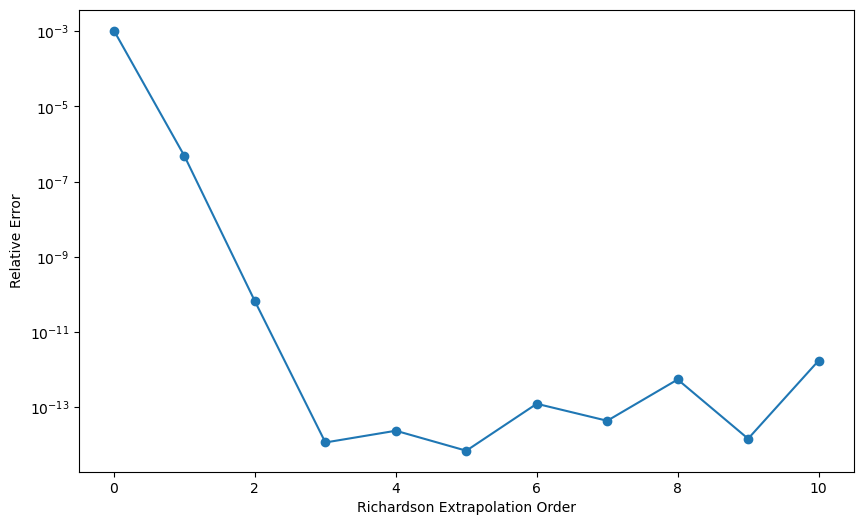

In [3]:
def relative_error(approx, exact):
    return np.abs(approx - exact) / np.abs(exact)

max_order = 10
relative_errors = []

# 计算不同外推次数下的相对精度
for order in range(max_order + 1):
    derivative_richardson = richardson_extrapolation(f, x0, h, three_point_midpoint, order)
    error = relative_error(derivative_richardson, exact_derivative)
    relative_errors.append(error)

# 输出结果
for order, error in enumerate(relative_errors):
    print(f"外推次数 {order}: 相对误差 = {error:.8e}")

# 绘制相对精度与外推次数的关系曲线
plt.figure(figsize=(10, 6))
plt.plot(range(max_order + 1), relative_errors, 'o-', label='Relative Error')
plt.xlabel('Richardson Extrapolation Order')
plt.ylabel('Relative Error')
plt.yscale('log')

Richardson 外推法的适用范围不仅限于数值微分，也可以用于许多其他数值计算问题，如积分、差分方程的解等. 

外推次数并不是越多越好，这里主要影响因素是舍入误差. 随着外推次数的增加，计算过程中涉及的步长变小，舍入误差的影响也会变得更显著. 在实践中，确定最佳外推次数通常通过试验来实现，逐步增加外推次数，直到误差不再显著减少或者计算成本变得过高. 

### Euler 法

Euler法是解决初值问题的基础数值方法，尽管其实际应用不多，但其简单的推导过程有助于我们理解更高级数值解法的构建. Euler法旨在求解以下形式的适定初值问题：$$\frac{{\rm{d}} y}{{\rm{d}} t} = f(t, y), \quad a \le t \le b, \quad y(a) = \alpha$$

该方法不是提供连续的函数作为解，而是在区间 $[a, b]$ 内的特定**离散点**上估计 $y$ 的值，这些点被称为**网格点** (mesh point). 一旦在这些网格点上估计出解的值，就可以使用**插值**方法估计区间内任何点的解.

通常从定义等间隔的网格点开始：选择一个正整数 $N$，定义步长 $h = \displaystyle\frac{b-a}{N}$，则网格点位置由下式给出：
$$t_i = a + ih, \quad i = 0, 1, 2, \dots, N$$
其中，$h = t_{i+1} - t_i$ 是相邻两个网格点间的**步长** (step size).


使用 Taylor 定理进行推导. 假设方程的唯一解 $y(t)$ 在区间 $[a,b]$ 上有连续的二阶导数，于是对每个 $i=0,1,\dots,N-1$ 有 $$y(t_{i+1})=y(t_i)+(t_{i+1}-t_i)y^\prime(t_i)+\frac{(t_{i+1}-t_i)^2}{2}y^{\prime\prime}(\xi_i),\quad t_i<\xi_i<t_{i+1}$$ 利用步长式子 $h=t_{i+1}-t_i$ 改写上式，得到 $$y(t_{i+1})=y(t_i)+hy^\prime(t_i)+\frac{h^2}{2}y^{\prime\prime}(\xi_i),\quad t_i<\xi_i<t_{i+1}$$ 

使用微分方程的已知条件代入得到 $$y(t_{i+1})=y(t_i)+hf(t_i,y(t_i))+\frac{h^2}{2}y^{\prime\prime}(\xi_i),\quad t_i<\xi_i<t_{i+1}$$

Euler 方法对每个 $i=1,2,\dots,N$ 构建 $w_i\approx y(t_i)$ 并删除余项. 因此我们得到以下递推关系：
$$\begin{align*}
&w_0=\alpha\\
&w_{i+1}=w_i+hf(t_i,w_i), \quad i=0,1,...,N-1
\end{align*}$$

其中 $w_{i+1}=w_i+hf(t_i,w_i)$ 又称做与 Euler 法关联的**差分方程** (difference equation).

> 【例 7.2】
>
> 使用 Euler 法的算法来近似计算常微分方程初值问题 $$y^\prime=y-t^2+1,\quad 0\le t\le 2,\quad y(0)=0.5$$ 在 $t=2$ 的解. 取步长 $h=0.5$.

对于本问题，$y^\prime=y-t^2+1$，通过 Euler 法构造如下
$$\begin{align*}
&w_0=y(0)=0.5\\
&w_1=w_0+0.5(w_0-t_0^2+1)=0.5+0.5\times(0.5-0.0^2+1)=1.25\\
&w_2=w_1+0.5(w_1-t_1^2+1)=1.25+0.5\times(1.25-0.5^2+1)=2.25\\
&w_3=w_2+0.5(w_2-t_2^2+1)=2.25+0.5\times(2.25-1.0^2+1)=3.375\\
&w_4=w_3+0.5(w_3-t_3^2+1)=3.375+0.5\times(3.375-1.5^2+1)=4.4375
\end{align*}$$

所求的值 $y(2)\approx w_4$.

<img src="./assets/euler.png" width="480" style="display: block;margin-left: auto;margin-right: auto;" />

In [4]:
import numpy as np
import pandas as pd

# 步骤1：将 Euler 步定义为单独的函数
def euler_step(f, t, w, h):
    return w + h * f(t, w)

# 步骤2：使用 Euler 方法将函数定义为迭代
def euler_method(f, a, b, alpha, h):
    N = int((b - a) / h)
    t_values = np.linspace(a, b, N+1)
    w_values = np.zeros(N+1)
    w_values[0] = alpha

    for i in range(N):
        w_values[i+1] = euler_step(f, t_values[i], w_values[i], h)
    
    return t_values, w_values

# 示例用法：求解微分方程 y' = y - t^2 + 1
def example_ode(t, y):
    return y - t**2 + 1

# 参数
a = 0
b = 2
alpha = 0.5
h = 0.5

# 用示例 ODE 调用 euler_method 函数
t_values, w_values = euler_method(example_ode, a, b, alpha, h)

# 将结果转换为 Pandas 数据框以更好地可视化
results_df = pd.DataFrame({
    "t": t_values,
    "w": w_values
})

results_df

,t,w
0,0.0,0.5000
1,0.5,1.2500
2,1.0,2.2500
3,1.5,3.3750
4,2.0,4.4375


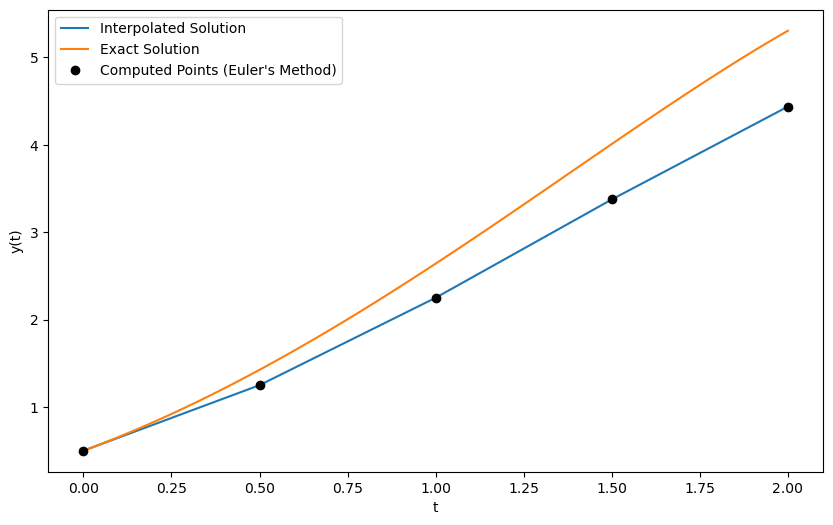

In [5]:
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d

# 定义插值函数
# 这里演示直接调用 SciPy 的库，详见对应文档
def interpolate_solution(t_values, w_values, kind='linear'):
    interpolation_func = interp1d(t_values, w_values, kind=kind)
    return interpolation_func

# 获取计算点的插值函数
interpolation_func = interpolate_solution(t_values, w_values)

# 生成一组密集的点，用于绘制插值解
t_dense = np.linspace(a, b, 100)
w_dense = interpolation_func(t_dense)

# 用于比较的精确解
def exact_solution(t):
    return (t + 1)**2 - 0.5 * np.exp(t)

# 计算密集点上的精确解
w_exact = exact_solution(t_dense)

# 画图
plt.figure(figsize=(10, 6))
plt.plot(t_dense, w_dense, '-', label="Interpolated Solution")
plt.plot(t_dense, w_exact, '-', label="Exact Solution")
plt.plot(t_values, w_values, 'ko', label="Computed Points (Euler's Method)")
plt.xlabel("t")
plt.ylabel("y(t)")
plt.legend()

#### 误差

假设 $f$ 是连续的，并且在 $$D=\{(t,y)|a\le t\le b, -\infty<y<\infty\} $$上满足常数 Lipschitz 条件，其 Lipschitz 常数为 $L$. 并且，存在一个常数 $M$ 使得 $$|y^{\prime\prime}(t)|\le M,\quad \forall t \in [a,b]$$
其中 $y(t)$ 表示初值问题 $$y^\prime=f(t,y),\quad a\le t\le b,\quad y(a)=\alpha$$ 的唯一解. 设对某一正整数 $N$， 序列$w_0,w_1,\dots,w_N$ 是通过 Euler 法产生的的近似值，那么，对于每个 $i=0,1,2,\dots,N$，有 $$|y(t_i)-w_i|\le \frac{hM}{2L}(e^{L(t_i-a)} -1)$$

可以看出，Euler 法产生的误差**线性**依赖于步长 $h$. 缩减步长有望获得更精确的近似结果. 

但是，随着 $h$ 越来越小，舍入误差造成的影响就必须估计了. 在实际计算中，差分方程带有一个舍入误差，即 $w_{i+1}=w_i+hf(t_i,w_i)+\delta_{i+1}$，下面的定理给出了考虑有限位算术时的 Euler 法误差界：

> 令 $y(t)$ 表示如下初值问题的唯一解 $$y^\prime=f(t,y),\quad a\le t\le b,\quad y(a)=\alpha$$
以及 $u_0,u_1,\dots,u_N$ 是近似值. 如果对每个 $i=0,1,\dots,N$有$|\delta_i|<\delta$ ，并且上一个定理成立，那么对于每个 $i=0,1,\dots,N$ 有
$$|y(t_i)-u_i|\le \frac{1}{L}\left(\frac{hM}{2}+\frac{\delta}{h}\right)(e^{L(t_i-a)}-1)+|\delta_0|e^{L(t_i-a)}$$



#### 局部阶段误差

在数值计算中，我们追求的是以尽可能少的计算成本来获得精确的近似结果. 为了评价不同数值方法的效率，需要一种衡量标准来比较这些方法在特定步骤上的效果. 局部截断误差是用来量化微分方程的精确解与差分方程近似值之间在某一步骤上的偏差大小.

> 差分方程\begin{align*}&w_0=\alpha\\&w_{i+1}=w_i+h\phi(t_i,w_i),\quad i=0,1,\dots,N-1\end{align*} 有**局部截断误差** (local truncation error) $$\tau_{i+1}(h)=\frac{y_{i+1}-(y_i+h\phi(t_i,y_i))}{h}=\frac{y_{i+1}-y_i}{h}-\phi(t_i,y_i)$$ 对每个 $i=0,1,\dots,N-1$，其中 $y_i$ 和 $y_{i+1}$ 分别是微分方程的解在 $t_i$ 和 $t_{i+1}$ 处的值.

以 Euler 法为例，在第 $i$ 步的局部截断误差表示成 $$\tau_{i+1}(h)=\frac{y_{i+1}-y_i}{h}-f(t_i,y_i)=\frac{h}{2}y^{\prime\prime}(\xi_i),\quad i=0,1,\dots,N-1$$ 其中 $\xi_i\in(t_i,t_{i+1})$. 

之所以叫做**局部**，是因为它衡量的是某个方法在某一特定步骤的准确性，并**假设**该方法在前一步骤是精确的. 

如果知道 $y^{\prime\prime}(t)$ 在 $[a,b]$ 上有一个常数界 $M$，就可以得到 $$|\tau_{i+1}(h)|\le \frac{h}{2}M$$ 如此得知，Euler 法的局部截断误差是 $O(h)$.

### Taylor 法

#### 一阶 Taylor 法

以差分方法求解常微分方程的一种思路是，在其局部截断误差为 $O(h^p)$ 时取得尽可能大的 $p$ 值，同时将这个方法的计算复杂度控制在合理范围内. 

由于 Euler 法是使用 Taylor 定理在 $n=1$ 的情况下对微分方程的解进行近似推导而得，它其实是一阶 Taylor 法. 因此考虑通过扩展到较大的 $n$ 值来改善差分方法收敛特性.

#### 高阶 Taylor 法

假设 $y(t)$ 是如下初值问题的解 $$y^\prime=f(t,y),\quad a\le t\le b,\quad y(a)=\alpha$$它有 $(n+1)$ 阶连续的导数. 如果在 $t_i$ 处使用 Taylor 多项式展开解 $y(t)$，并求 $t_{i+1}$ 处的值，得到 $$y(t_{i+1})=y(t_i)+hy^\prime(t_i)+\frac{h^2}{2}y^{\prime\prime}(t_i)+\dots+\frac{h^n}{n!}y^{(n)}(t_i)+\frac{h^{n+1}}{(n+1)!}y^{(n+1)}(\xi_i),\quad t_i<\xi_i<t_{i+1}$$

连续求解 $y(t)$ 的导数，就得到 $$y^\prime(t)=f(t,y(t)),\quad y^{\prime\prime}(t)=f^\prime(t,y(t)),\quad\dots,\quad y^{(k)}(t)=f^{(k-1)}(t,y(t))$$ 

代入 Taylor 展开的方程就得到差分方程 $$y(t_{i+1})=y(t_i)+hf(t,y(t_i))+\frac{h^2}{2}f^\prime(t,y(t_i))+\dots+\frac{h^n}{n!}f^{(n-1)}(t_i,y(t_i))+\frac{h^{n+1}}{(n+1)!}f^{(n)}(\xi_i,y(\xi_i))$$

因此有

\begin{align*}
&w_0=\alpha\\
&w_{i+1}=w_i+hT^{(n)}(t_i,w_i), \quad i=0,1,...,N-1
\end{align*}

其中 $$T^{(n)}(t_i,w_i)=f(t_i,w_i)+\frac{h}{2}f^\prime(t_i,w_i)+\dots+\frac{h^{n-1}}{n!}f^{(n-1)}(t_i,w_i)$$

> 【例 7.3】
>
> 使用四阶 Taylor 法来近似计算常微分方程初值问题 $$y^\prime=y-t^2+1,\quad 0\le t\le 2,\quad y(0)=0.5$$ 在 $t=2$ 的解. 取$N=10$.

为了得到四阶表达式，需要得到 $f(t,y(t))$ 关于 $t$ 的前三阶导数. 因此
$$\begin{align*}
&f^\prime(t,y(t))=\frac{{\rm{d}}}{{\rm{d}} t}(y-t^2+1)=y^\prime-2t=y-t^2+1-2t\\
&f^{\prime\prime}(t,y(t))=\frac{{\rm{d}}}{{\rm{d}} t}(y-t^2+1-2t)=y^\prime-2t-2=y-t^2+1-2t-2=y-t^2-2t-1\\
&f^{\prime\prime\prime}(t,y(t))=\frac{{\rm{d}}}{{\rm{d}} t}(y-t^2-2t-1)=y^\prime-2t-2=y-t^2+1-2t-2=y-t^2-2t-1
\end{align*}$$

$$\begin{align*}
T^{(4)}(t_i,w_i)&=f(t_i,w_i)+\frac{h}{2}f^\prime(t_i,w_i)+\frac{h^2}{6}f^{\prime\prime}(t_i,w_i)+\frac{h^3}{24}f^{\prime\prime\prime}(t_i,w_i)\\
&=w_i-t_i^2+1+\frac{h}{2}(w_i-t_i^2+1-2t_i)+\frac{h^2}{6}(w_i-t_i^2-2t_i-1)\\
&+\frac{h^3}{24}(w_i-t_i^2-2t_i-1)
\end{align*}$$

因此，对于 $i=0,1,\dots,N-1$，四阶 Taylor 方法有

$$\begin{align*}
&w_0=0.5\\
&w_{i+1}=w_i+h\left[\left(1+\frac{h}{2}+\frac{h^2}{6}+\frac{h^3}{24}\right)(w_i-t_i^2)-\left(1+\frac{h}{3}+\frac{h^2}{12}\right)ht_i+1+\frac{h}{2}-\frac{h^2}{6}-\frac{h^3}{24}\right]
\end{align*}$$

因为 $N=10$，所以 $h=0.2$，代入数据，得到近似结果如表所示

| $$t_i$$ | $$w_i$$ | $$|y(t_i)-w_i|$$ |
|--|--|--|
|0.0                    | 0.500000              | 0                     |
|0.2                    | 0.829300              | 0.000001              |
|0.4                    | 1.214091              | 0.000003              |
|0.6                    | 1.648947              | 0.000006              |
|0.8                    | 2.127240              | 0.000010              |
|1.0                    | 2.640874              | 0.000015              |
|1.2                    | 3.179964              | 0.000023              |
|1.4                    | 3.732432              | 0.000032              |
|1.6                    | 4.283529              | 0.000045              |
|1.8                    | 4.815238              | 0.000062              |
|2.0                    | 5.305555              | 0.000083              |

Taylor 法优点是具有高阶局部截断误差，缺点则是需要计算 $f(t,y)$ 的导数值. 很少用于实际计算.

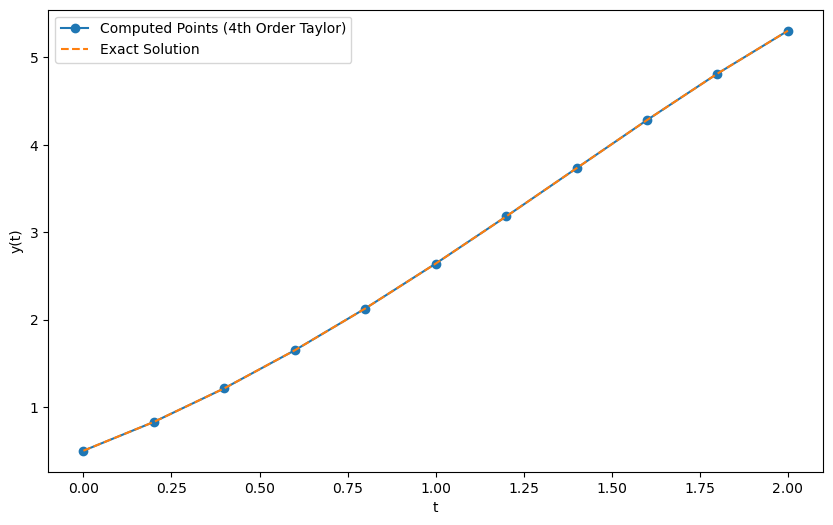

,t,w
0,0.0,0.500000
1,0.2,0.829300
2,0.4,1.214091
3,0.6,1.648947
4,0.8,2.127240
5,1.0,2.640874
6,1.2,3.179964
7,1.4,3.732432
8,1.6,4.283529
9,1.8,4.815238


In [6]:
def taylor_step(f, fp, fpp, fppp, t, w, h):
    term1 = f(t, w)
    term2 = (h / 2) * fp(t, w)
    term3 = (h**2 / 6) * fpp(t, w)
    term4 = (h**3 / 24) * fppp(t, w)
    return w + h * (term1 + term2 + term3 + term4)

def taylor_method(f, fp, fpp, fppp, a, b, alpha, N):
    h = (b - a) / N
    t_values = np.linspace(a, b, N+1)
    w_values = np.zeros(N+1)
    w_values[0] = alpha

    for i in range(N):
        w_values[i+1] = taylor_step(f, fp, fpp, fppp, t_values[i], w_values[i], h)
    
    return t_values, w_values

# 定义示例 ODE 的导数
def f(t, y):
    return y - t**2 + 1

def fp(t, y):
    return y - t**2 + 1 - 2*t

def fpp(t, y):
    return y - t**2 - 2*t - 1

def fppp(t, y):
    return y - t**2 - 2*t - 1

a = 0
b = 2
alpha = 0.5
N = 10

t_values, w_values = taylor_method(f, fp, fpp, fppp, a, b, alpha, N)

# 用参与数值计算的网格点检验精确解，不再演示插值过程
w_exact = exact_solution(t_values)

plt.figure(figsize=(10, 6))
plt.plot(t_values, w_values, 'o-', label="Computed Points (4th Order Taylor)")
plt.plot(t_values, w_exact, '--', label="Exact Solution")
plt.xlabel("t")
plt.ylabel("y(t)")
plt.legend()
plt.show()

results_df = pd.DataFrame({
    "t": t_values,
    "w": w_values
})

results_df

### Runge-Kutta 法

Runge-Kutta 法既有 Taylor 法一样的高阶局部截断误差，又不需要计算 $f(t,y)$ 的导数值. 我们考虑双变量的 Taylor 定理.

> 假设 $f(t,y)$ 及其所有小于或等于 $n+1$ 阶的偏导数在 $D=\{(t,y)|a\le t\le b, c\le y \le d\}$ 上是连续的，并且令 $(t_0,y_0)\in D$. 对于每一个 $(t,y)\in D$，在 $t$ 和 $t_0$ 之间存在 $\xi$，在 $y$ 和 $y_0$ 之间存在 $\mu$，且$f(t,y)=P_n(t,y)+R_n(t,y)$，其中 $$\begin{align*}P_n(t,y)&=f(t_0,y_0)+\left[(t-t_0)\frac{\partial f}{\partial t}(t_0,y_0)+(y-y_0)\frac{\partial f}{\partial y}(t_0,y_0)\right]+\left[\frac{(t-t_0)^2}{2}\frac{\partial^2 f}{\partial t^2}(t_0,y_0)+(t-t_0)(y-y_0)\frac{\partial^2 f}{\partial t\partial y}(t_0,y_0)+\frac{(y-y_0)^2}{2}\frac{\partial^2 f}{\partial y^2}(t_0,y_0)\right]+\dots\\&+\left[\frac{1}{n!}\sum_{j=0}^n\begin{pmatrix}n \\ j \end{pmatrix}(t-t_0)^{n-j}(y-y_0)^{j}\frac{\partial^n f}{\partial t^{n-j}\partial y^j}(t_0,y_0)\right]\end{align*}$$ $$R_n(t,y)=\frac{1}{(n+1)!}\sum_{j=0}^{n+1}\begin{pmatrix}n+1 \\ j \end{pmatrix}(t-t_0)^{n+1-j}(y-y_0)^{j}\frac{\partial^{n+1} f}{\partial t^{n+1-j}\partial y^j}(\xi,\mu)$$

#### 二阶 Runge-Kutta 法

试确定 $k_1$、$\alpha_1$ 和 $\beta_1$，使得 $k_1f(t+\alpha_1,y+\beta_1)$ 与 $$T^{(2)}=f(t,y)+\frac{h}{2}f^\prime(t,y)$$ 近似误差不超过 $O(h^2)$. 因为 $$f^\prime(t,y)=\frac{{\rm{d}} f}{{\rm{d}} t}(t,y)=\frac{\partial f}{\partial t}(t,y)+\frac{\partial f}{\partial y}(t,y)\cdot y^\prime(t),\quad y^\prime(t)=f(t,y)$$ 我们有 $$T^{(2)}(t,y)=f(t,y)+\frac{h}{2}\frac{\partial f}{\partial t}(t,y)+\frac{h}{2}\frac{\partial f}{\partial y}(t,y)\cdot f(t,y)$$

将 $f(t+\alpha_1,y+\beta_1)$ 在点 $(t,y)$ 处展开成一阶 Taylor 多项式，有 $$k_1f(t+\alpha_1,y+\beta_1)=k_1f(t,y)+k_1\alpha_1\frac{\partial f}{\partial t}(t,y)+k_1\beta_1\frac{\partial f}{\partial y}(t,y)+k_1R_1(t+\alpha_1,y+\beta_1)$$ 其中，$$R_1(t+\alpha_1,y+\beta_1)=\frac{\alpha_1^2}{2}\frac{\partial^2 f}{\partial t^2}(\xi,\mu)+\alpha_1\beta_1\frac{\partial^2 f}{\partial t \partial y}(\xi,\mu)+\frac{\beta_1^2}{2}\frac{\partial^2 f}{\partial y^2}(\xi,\mu)$$

比较方程系数，得到 $$k_1=1;\quad k_1\alpha_1=\frac{h}{2};\quad k_1\beta_1=\frac{h}{2}f(t,y)$$ 由此得到 $$k_1=1,\quad\alpha_1=\frac{h}{2},\quad\beta_1=\frac{h}{2}f(t,y)$$ 因此 $$T^{(2)}(t,y)=f\left(t+\frac{h}{2},y+\frac{h}{2}f(t,y)\right)-R_1\left(t+\frac{h}{2},y+\frac{h}{2}f(t,y)\right)$$

从余项 $R_1$ 可知 $$R_1\left(t+\frac{h}{2},y+\frac{h}{2}f(t,y)\right)=\frac{h^2}{8}\frac{\partial^2 f}{\partial t^2}(\xi,\mu)+\frac{h^2}{4}f(t,y)\frac{\partial^2 f}{\partial t \partial y}(\xi,\mu)+\frac{h^2}{8}(f(t,y))^2\frac{\partial^2 f}{\partial y^2}(\xi,\mu)$$

如果 $f$ 的所有二阶偏导数都有界，则 $\displaystyle R_1(t+\frac{h}{2},y+\frac{h}{2}f(t,y))$ 是 $O(h^2)$. 因此该方法的误差的阶数与二阶 Taylor 法的误差的阶数相同.

#### 中点法

用 $\displaystyle f(t+\frac{h}{2},y+\frac{h}{2}f(t,y))$ 替代二阶 Taylor 法的 $T^{(2)}(t,y)$，得到的差分方程是一个特殊的 Runge-Kutta 法，叫做**中点法** (midpoint method)，即

$$\begin{align*}
&w_0=\alpha\\
&w_{i+1}=w_i+hf\left(t_i+\frac{h}{2},w_i+\frac{h}{2}f(t_i,w_i)\right)
\end{align*}$$

#### 改进的 Euler 法

中点法只有 3 个参数出现在公式 $k_1f(t+\alpha_1,y+\beta_1)$ 中.用来近似 $$T^{(3)}(t,y)=f(t,y)+\frac{h}{2}f^\prime(t,y)+\frac{h^2}{6}f^{\prime\prime}(t,y)$$ 的 4 参数公式是 $$k_1f(t,y)+k_2f(t+\alpha_2,y+\delta_2f(t,y))$$
所得到的差分方程的最好误差仍然是 $O(h^2)$ 局部截断误差. 其中最重要的一个公式叫做**改进的 Euler 法** (modified Euler method)，取 $k_1=k_2=\frac{1}{2},\alpha_2=\delta_2=h$， 即

$$\begin{align*}
&w_0=\alpha\\
&w_{i+1}=w_i+\frac{h}{2}\left[f(t_i,w_i)+f(t_{i+1},w_i+hf(t_i,w_i))\right]
\end{align*}$$

#### 四阶 Runge-Kutta 法

四阶 Runge-Kutta 法有 $O(h^4)$ 的局部截断误差，因此在高阶 Runge-Kutta 法中比较常用. 对每个 $i=0,1,\dots,N-1$有

$$\begin{align*}
&w_0=\alpha\\
&k_1=hf(t_i,w_i)\\
&k_2=hf\left(t_i+\frac{h}{2},w_i+\frac{1}{2}k_1\right)\\
&k_3=hf\left(t_i+\frac{h}{2},w_i+\frac{1}{2}k_2\right)\\
&k_4=hf(t_{i+1},w_i+k_3)\\
&w_{i+1} = w_i+\frac{1}{6}(k_1+2k_2+2k_3+k_4)
\end{align*}$$

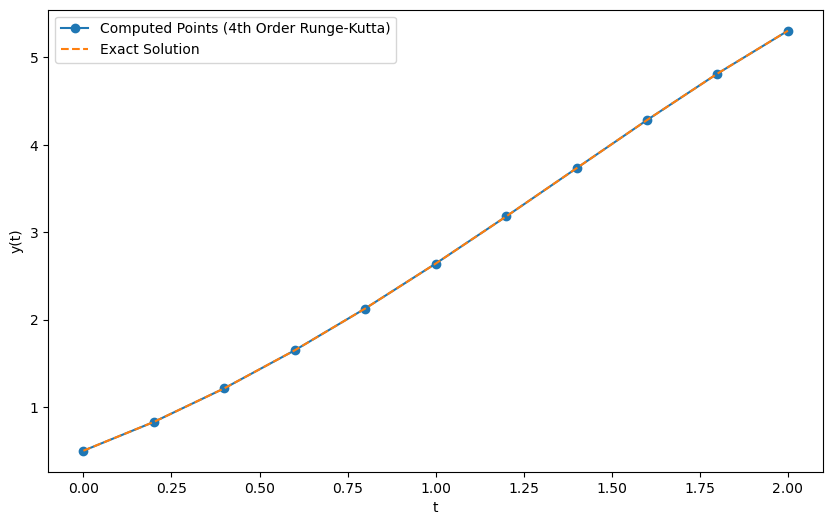

,t,w,error
0,0.0,0.500000,0.000000
1,0.2,0.829293,0.000005
2,0.4,1.214076,0.000011
3,0.6,1.648922,0.000019
4,0.8,2.127203,0.000027
5,1.0,2.640823,0.000036
6,1.2,3.179894,0.000047
7,1.4,3.732340,0.000060
8,1.6,4.283409,0.000074
9,1.8,4.815086,0.000091


In [7]:
def runge_kutta_step(f, t, w, h):
    k1 = h * f(t, w)
    k2 = h * f(t + h/2, w + k1/2)
    k3 = h * f(t + h/2, w + k2/2)
    k4 = h * f(t + h, w + k3)
    return w + (k1 + 2*k2 + 2*k3 + k4) / 6

def runge_kutta_method(f, a, b, alpha, N):
    h = (b - a) / N
    t_values = np.linspace(a, b, N+1)
    w_values = np.zeros(N+1)
    w_values[0] = alpha

    for i in range(N):
        w_values[i+1] = runge_kutta_step(f, t_values[i], w_values[i], h)
    
    return t_values, w_values

a = 0
b = 2
alpha = 0.5
N = 10

t_values, w_values = runge_kutta_method(example_ode, a, b, alpha, N)

w_exact = exact_solution(t_values)

# Plot the results
plt.figure(figsize=(10, 6))
plt.plot(t_values, w_values, 'o-', label="Computed Points (4th Order Runge-Kutta)")
plt.plot(t_values, w_exact, '--', label="Exact Solution")
plt.xlabel("t")
plt.ylabel("y(t)")
plt.legend()
plt.show()

results_df = pd.DataFrame({
    "t": t_values,
    "exact": w_exact,
    "w": w_values
})

# 用 Pandas 演示计算误差
results_df["error"] = np.abs(results_df["exact"] - results_df["w"])
del results_df["exact"]
results_df

### 多步法

使用**一个以上**前面介绍的网格点的近似值来确定后一个网格点的近似值的方法称为**多步** (multistep) 法. 

近似求解初值问题 $$y^\prime=f(t,y),\quad a\le t\le b,\quad y(a)=\alpha$$ 的 **$m$ 步法** ($m$-step multistep method) 是这样一个差分方程，它由下面的方程表示求网格点 $t_{i+1}$ 处的近似解 $w_{i+1}$：

$$\begin{align*}
w_{i+1}=&a_{m-1}w_i+a_{m-2}w_{i-1}+\dots+a_0w_{i+1-m}\\
&+h[b_mf(t_{i+1},w_{i+1})+b_{m-1}f(t_i,w_i)+\dots+b_0f(t_{i+1-m},w_{i+1-m})]\quad (i=m-1,m,\dots,N-1)
\end{align*}$$

其中 $m$ 是大于1的整数，$h=(b-a)/N$，$a_0,a_1,\dots,a_{m-1}$和$b_0,b_1,\dots,b_m$都是常数，初始值为$$w_0=\alpha,\quad w_1=\alpha_1,\quad w_2=\alpha_2,\quad \dots,\quad w_{m-1}=\alpha_{m-1}$$

#### 显式方法、隐式方法

$$\begin{align*}
w_{i+1}=&a_{m-1}w_i+a_{m-2}w_{i-1}+\dots+a_0w_{i+1-m}+h[{\color{sintefblue}{b_m}}f(t_{i+1},w_{i+1})+b_{m-1}f(t_i,w_i)+\dots\\
&+b_0f(t_{i+1-m},w_{i+1-m})]\quad (i=m-1,m,\dots,N-1)
\end{align*}$$

- 当 $b_m=0$ 时，方法称为**显式** (explicit) 的，或者称为**开** (open) 的，因为方程中 $w_{i+1}$ 由前面已经确定的值显式地表示
- 当 $b_m\ne 0$ 时，方法称为**隐式** (implicit)的，或者称为**闭** (closed) 的，因为方程中 $w_{i+1}$ 位于方程两边，只能隐式地确定.

例如

- Adam-Bashforth 二步显式方法 \begin{align*}&w_0=\alpha,\quad w_1=\alpha_1,\\&w_{i+1}=w_i+\frac{h}{2}[3f(t_i,w_i)-f(t_{i-1},w_{i-1})]\end{align*}
- Adam-Moulton 二步隐式方法 \begin{align*}&w_0=\alpha,\quad w_1=\alpha_1,\\&w_{i+1}=w_i+\frac{h}{12}[5f(t_{i+1},w_{i+1})+8f(t_i,w_i)-f(t_{i-1},w_{i-1})]\end{align*}

#### 预估-校正

通常，相同阶数的方法，隐式比显式具有更好的近似解. 但是，隐式方法涉及用代数方法求解 $w_{i+1}$ 的显式表达式. 

实践中，可以先用显式方法得到一个预估，再用隐式方法来校正这个预估. 预估的显式方法和改善预估的隐式方法的结合称为**预估-校正方法** (predictor-corrector method).

例如，先用 Euler 公式得到一个预估值 $$\hat{w}_{i+1}=w_i+hf(t_i,w_i)$$ 尽管 $\hat{w}_{i+1}$ 的精度不高，但是我们可以将之作为初始值代入梯形求积公式，迭代得到校正值 $$w_{i+1}=w_i+\frac{h}{2}\left[f(t_i,w_i)+f(t_{i+1},\hat{w}_{i+1})\right]$$

可以验证，如果把预估值 $\hat{w}_{i+1}$ 代入梯形求积公式，这实际上就得到了改进的 Euler 法. 

### 微分方程组

Lipschitz 条件确保了一阶微分方程组的解的存在性和唯一性. 我们可以推广经典的四阶 Runge-Kutta 法来求解微分方程组. 

选择一个整数 $N>0$，并设定 $h=\displaystyle\frac{b-a}{N}$. 将区间 $[a,b]$ 划分为 $N$ 个子区间，网格点为 $$t_j =a+jh,\quad j=0,1,\dots,N$$
对于每个 $j=0,1,\dots,N$ 和 $i=1,2,\dots,m$ 用符号 $w_{ij}$ 表示对 $u_i(t_j)$ 的近似值. 即，$w_{ij}$ 近似于方程组的第 $j$ 个网格点 $t_j$ 的第 $i$ 个解 $u_i(t)$. 对于初始条件，设定 $$w_{1,0}=\alpha_1,\quad w_{2,0}=\alpha_2,\quad \dots,\quad w_{m,0}=\alpha_m$$

<img src="./assets/linear.png" width="900" style="display: block;margin-left: auto;margin-right: auto;" />

#### 微分方程组的 Runge-Kutta 法

假设已经计算了 $w_{1,j},w_{2,j},\dots,w_{m,j}$ 的值，要得到 $w_{1,j+1},w_{2,j+1},\dots, w_{m,j+1}$，首先计算 

$$\begin{align*}
&k_{1,i} = hf_i(t_j,w_{1,j},w_{2,j},\dots,w_{m,j})\\
&k_{2,i} = hf_i\left(t_j + \frac{h}{2},w_{1,j} + \frac{1}{2}k_{1,1},w_{2,j} + \frac{1}{2}k_{1,2},\dots,w_{m,j} + \frac{1}{2}k_{1,m}\right)\\
&k_{3,i} = hf_i\left(t_j + \frac{h}{2},w_{1,j} + \frac{1}{2}k_{2,1},w_{2,j} + \frac{1}{2}k_{2,2},\dots,w_{m,j} + \frac{1}{2}k_{2,m}\right)\\
&k_{4,i} = hf_i(t_j +h,w_{1,j} +k_{3,1},w_{2,j} +k_{3,2},\dots,w_{m,j} +k_{3,m})\\
&w_{i,j+1} = w_{i,j} + \frac{1}{6}(k_{1,i} +2k_{2,i} +2k_{3,i} +k_{4,i})
\end{align*}$$

对每个 $i=1,2,\dots,m$ 适用. 

注意，在确定形如 $k_{2,i}$ 的任何项之前，必须计算 $k_{1,1},k_{1,2},\dots,k_{1,m}$ 的值. 一般地，在计算形如 $k_{l+1,i}$ 的项之前，都必须计算 $k_{l,1},k_{l,2},\dots,k_{l,m}$.

### 线性边值问题

若存在函数 $p(x)$、$q(x)$ 和 $r(x)$ 使得 $$f(x,y,y^\prime)=p(x)y^\prime+q(x)y+r(x)$$ 则微分方程 $$y^{\prime\prime}=f(x,y,y^\prime)$$ 是线性的. 

> 假设线性边值问题 $$y^{\prime\prime}=p(x)y^\prime+q(x)y+r(x),\quad a\le x\le b,\quad y(a)=\alpha,\quad y(b)=\beta$$ 满足
>
> - $p(x)$、$q(x)$ 和 $r(x)$ 在区间 $[a,b]$ 上连续
> - 在区间 $[a,b]$ 上，有 $q(x)>0$

为了近似计算线性问题的唯一解，首先考虑如下初值问题：

$$
y^{\prime\prime}=p(x)y^\prime+q(x)y+r(x),\quad a\le x\le b,\quad y(a)=\alpha,\quad y^\prime(a)=0
$$
和
$$
y^{\prime\prime}=p(x)y^\prime+q(x)y,\quad a\le x\le b,\quad y(a)=0,\quad y^\prime(a)=1
$$
这两个方程都有唯一解. 分别用 $y_1(x)$ 和 $y_2(x)$ 表示两个方程的解. 假设 $y_2(b)\ne0$，定义
$$
y(x)=y_1(x)+\frac{\beta-y_1(b)}{y_2(b)}y_2(x)
$$
它是前一个方程的解. 可得到 $$y^\prime(x)=y_1^\prime(x)+\frac{\beta-y_1(b)}{y_2(b)}y_2^\prime(x),\quad y^{\prime\prime}(x)=y_1^{\prime\prime}(x)+\frac{\beta-y_1(b)}{y_2(b)}y_2^{\prime\prime}(x)$$

将之代入方程可得到
$$\begin{align*}
y^{\prime\prime}&=p(x)y_1^\prime+q(x)y_1+r(x)+\frac{\beta-y_1(b)}{y_2(b)}(p(x)y_2^\prime+q(x)y_2)\\
&=p(x)\left(y_1^\prime(x)+\frac{\beta-y_1(b)}{y_2(b)}y_2^\prime(x)\right)+q(x)\left(y_1+\frac{\beta-y_1(b)}{y_2(b)}y_2\right)+r(x)\\
&=p(x)y^\prime(x)+q(x)y(x)+r(x)
\end{align*}$$
且有 $$y(a)=y_1(a)+\frac{\beta-y_1(b)}{y_2(b)}y_2(a)=\alpha+0=\alpha$$ 和 $$y(b)=y_1(b)+\frac{\beta-y_1(b)}{y_2(b)}y_2(b)=y_1(b)+\beta-y_1(b)=\beta$$

#### 线性打靶法

**打靶法** (shooting method) 是把边值问题转换为初值问题的一类方法. 

线性打靶法将线性边值问题用两个线性初值问题来替换. 一旦求得 $y_1(x)$ 和 $y_2(x)$ 的近似解，就可以用 $$y(x)=y_1(x)+\frac{\beta-y_1(b)}{y_2(b)}y_2(x)$$ 来近似计算边值问题的解. 

<img src="./assets/shooting.png" width="480" style="display: block;margin-left: auto;margin-right: auto;" />

把方程 $$y^{\prime\prime}=p(x)y^\prime+q(x)y+r(x),\quad a\le x\le b,\quad y(a)=\alpha,\quad y^\prime(a)=0$$ 改写成线性方程组. 

令 $z_1(x)=y(x),z_2(x)=y^\prime(x)$，则有

$$\begin{align*}
&z_1^\prime(x)=z_2(x)\\
&z_2^\prime(x)=p(x)z_2(x)+q(x)z_1(x)+r(x)
\end{align*}$$
其中 $a\le x\le b$ 且有 $z_1(a)=\alpha,z_2(a)=0$. 

把方程 $$y^{\prime\prime}=p(x)y^\prime+q(x)y,\quad a\le x\le b,\quad y(a)=0,\quad y^\prime(a)=1
$$ 改写成线性方程组. 

令 $z_3(x)=y(x),z_4(x)=y^\prime(x)$，则有

$$\begin{align*}
&z_3^\prime(x)=z_4(x)\\
&z_4^\prime(x)=p(x)z_4(x)+q(x)z_3(x)
\end{align*}$$
其中 $a\le x\le b$ 且有 $z_3(a)=0,z_4(a)=1$. 

因此可以用四阶 Runge-Kutta 法来近似求解.

#### 非线性打靶法

对于非线性二阶边值问题 $$y^{\prime\prime}=f(x,y,y^\prime),\quad a\le x\le b,\quad y(a)=\alpha,\quad y(b)=\beta$$ 无法表示成两个初值问题的解的线性组合. 为此，需要用一系列包含参数 $t$ 的初值问题的近似解来逼近，即

$$y^{\prime\prime}=f(x,y,y^\prime),\quad a\le x\le b,\quad y(a)=\alpha,\quad y^\prime(a)=t$$

通过选择 $t=t_k$，使其满足 $$\lim_{k\to\infty}y(b,t_k)=y(b)=\beta$$ 其中，$y(x,t_k)$ 是这个初值问题在 $t=t_k$ 时的解，$y(x)$ 是原来的边值问题的解.

从选择“斜率”参数 $t_0$ 开始，它相当于从点 $(a,\alpha)$ 出发沿下面的初值问题解的曲线“打靶”所达到的初始位置 $$y^{\prime\prime}=f(x,y,y^\prime),\quad a\le x\le b$$ $$y(a)=\alpha,\quad y^\prime(a)=t_k$$ 如果 $y(b,t_0)$ 不够接近 $\beta$，则继续选择参数 $t_{k+1}$ 来校正，直至充分接近 $\beta$.

<img src="./assets/shooting-t.png" width="480" style="display: block;margin-left: auto;margin-right: auto;" />

##### 基于 Newton 迭代的非线性打靶法

下面确定 $t_k$. 如果 $y(x,t)$ 是上面初值问题的解，那么要从下面的非线性方程中确定 $t$：$$y(b,t)-\beta=0$$ 这是一个求根问题，可以用基于 Newton 法的方法来确定，由此产生序列 $\{t_k\}$，即 $$t_k=t_{k-1}-\frac{y(b,t_{k-1})-\beta}{\displaystyle\frac{{\rm{d}} y}{{\rm{d}} t}(b,t_{k-1})}$$
但是我们并不知道 $y(b,t)$ 的显式表达式. 为了确定当 $t=t_{k-1}$ 时的 $\displaystyle\frac{{\rm{d}} y}{{\rm{d}} t}(b,t)$，改写此问题，强调对 $x$ 和 $t$ 的依赖形式
$$
y^{\prime\prime}(x,t)=f(x,y(x,t),y^\prime(x,t)),\quad a\le x\le b,\quad y(a,t)=\alpha,\quad y^\prime(a,t)=t
$$

对它求偏导数，有
$$\begin{align*}
\frac{\partial y^{\prime\prime}}{\partial t}(x,t)&=\boxed{\frac{\partial f}{\partial x}\frac{\partial x}{\partial t}}+\frac{\partial f}{\partial y}\frac{\partial y}{\partial t}(x,t)+\frac{\partial f}{\partial y^\prime}\frac{\partial y^\prime}{\partial t}(x,t)\\
&=\frac{\partial f}{\partial y}\frac{\partial y}{\partial t}(x,t)+\frac{\partial f}{\partial y^\prime}\frac{\partial y^\prime}{\partial t}(x,t)
\end{align*}$$

框起来的部分表示已消除. 注意其中的 $f=f(x,y(x,t),y^\prime(x,t))$，以及 $x$ 和 $t$ 相互独立因此 $\displaystyle\frac{\partial x}{\partial t}=0$. 相应地，初始条件变为 $$\frac{\partial y}{\partial t}(a,t)=0,\quad \frac{\partial y^\prime}{\partial t}(a,t)=1$$

简化记号，令 $z(x,t)=\displaystyle\frac{\partial y}{\partial t}(x,t)$，则上式可以变成如下初值问题
$$
z^{\prime\prime}(x,t)=\frac{\partial f}{\partial y}(x,y,y^\prime)z(x,t)+\frac{\partial f}{\partial y^\prime}(x,y,y^\prime)z^\prime(x,t),\quad a\le x\le b,\quad z(a,t)=0,\quad z^\prime(a,t)=1
$$

因此，在每一步迭代中，Newton 法需要求解两个初值问题，如此可得 $$t_k=t_{k-1}-\frac{y(b,t_{k-1})-\beta}{z(b,t_{k-1})}$$ 显然，这些初值问题都需要近似求解.

### 有限差分法

打靶法可能不稳定. 有限差分方法用差商公式代替微分方程中出现的导数，这种方法有很好的稳定性，但是一般来说，要达到某个要求的精度，需要更多的计算量.

技术上，选取特殊的差商公式及步长 $h$ 来保证截断误差有具体的阶. 然而，$h$ 不能取得太小，因为导数的近似公式一般是不稳定的. 

#### 离散近似

考虑以下二阶线性边值问题 $$y^{\prime\prime}=p(x)y^\prime+q(x)y+r(x),\quad a\le x\le y,\quad y(a)=\alpha,\quad y(b)=\beta$$ 要求用差商近似法来近似 $y^\prime$ 和 $y^{\prime\prime}$. 首先选择一个整数 $N>0$，将区间 $[a,b]$ 划分为 $(N+1)$ 个相等的子区间，其端点为网格点 $x_i=a+ih$，其中 $h=\displaystyle\frac{b-a}{N+1}$ 且 $i=0,1,\dots,N+1$. 以这种方式选择步长 $h$ 有利于应用矩阵算法，以便求解涉及 $N\times N$ 矩阵的线性方程组. 

在内部网格点 $x_i\,(i=1,2,...,N)$，我们要近似处理的微分方程是
$$
y^{\prime\prime}(x_i)=p(x_i)y^\prime(x_i)+q(x_i)y(x_i)+r(x_i)
$$

#### 线性有限差分

假设 $y\in C^4[x_{i-1},x_{i+1}]$，将 $y$ 在 $x_i$ 处展开成三次 Taylor 多项式并在 $x_{i-1}$ 和 $x_{i+1}$ 处求值，有
$$y(x_{i-1})=y(x_i-h)=y(x_i)-hy^\prime(x_i)+\frac{h^2}{2}y^{\prime\prime}(x_i)-\frac{h^3}{6}y^{\prime\prime\prime}(x_i)+\frac{h^4}{24}y^{(4)}(\xi_i^-),\quad \xi_i^-\in(x_{i-1},x_i)$$
$$y(x_{i+1})=y(x_i+h)=y(x_i)+hy^\prime(x_i)+\frac{h^2}{2}y^{\prime\prime}(x_i)+\frac{h^3}{6}y^{\prime\prime\prime}(x_i)+\frac{h^4}{24}y^{(4)}(\xi_i^+),\quad \xi_i^+\in(x_i,x_{i+1})$$
两式相加，从中解出 $y^{\prime\prime}(x_i)$，有
$$y^{\prime\prime}(x_i)=\frac{1}{h^2}[y(x_{i-1})-2y(x_i)+y(x_{i+1})]-\frac{h^2}{24}[y^{(4)}(\xi_i^-)+y^{(4)}(\xi_i^+)]$$
利用中值定理简化误差项，得到 $y^{\prime\prime}(x_i)$ 的**中心差分公式**
$$y^{\prime\prime}(x_i)=\frac{1}{h^2}[y(x_{i-1})-2y(x_i)+y(x_{i+1})]-\frac{h^2}{12}y^{(4)}(\xi_i),\quad \xi_i\in(x_{i-1},x_{i+1})$$

我们在数值微分中已经推导过 $y^{\prime}(x_i)$ 的**中心差分公式**，即三点式（中点式）
$$y^{\prime}(x_i)=\frac{1}{2h}[y(x_{i+1})-y(x_{i-1})]-\frac{h^2}{6}y^{\prime\prime\prime}(\zeta_i),\quad \zeta_i\in(x_{i-1},x_{i+1})$$

对离散近似得到的方程代入这些中心差分公式，以 $O(h^2)$ 的截断误差近似，就得到
$$\frac{y(x_{i+1})-2y(x_i)+y(x_{i-1})}{h^2}=p(x_i)\frac{y(x_{i+1})-y(x_{i-1})}{2h}+q(x_i)y(x_i)+r(x_i)$$
加上边界条件 $y(a)=\alpha$ 和 $y(b)=\beta$ 就得到用于计算的线性方程组
$$w_0=\alpha,\quad w_{N+1}=\beta$$
$$\left(\frac{-w_{i+1}+2w_i-w_{i-1}}{h^2}\right)+p(x_i)\left(\frac{w_{i+1}-w_{i-1}}{2h}\right)+q(x_i)w_i=-r(x_i)$$
其中 $i=1,2,\dots,N$.

这可以用代数方法求解. 对于内部网格点的方程，将 $w_{i-1},w_i,w_{i+1}$ 移至方程左边，其余放在方程右边. 如此即可改写成 $N\times N$ 的三对角矩阵形式，即 $${\boldsymbol{A}}{\boldsymbol{w}}={\boldsymbol{b}}$$ 其中 $${\boldsymbol{A}}=\begin{bmatrix}
2+h^2q(x_1)  & -1+\displaystyle\frac{hp(x_1)}{2} &            0 & \dots & \dots & 0 \\
-1-\displaystyle\frac{hp(x_2)}{2} & 2+h^2q(x_2)  & -1-\displaystyle\frac{hp(x_2)}{2} & \dots & \dots & 0 \\
           0 & -1-\displaystyle\frac{hp(x_3)}{2} & 2+h^2q(x_3)  & \dots & \dots & 0 \\
      \vdots &       \vdots &       \vdots & \ddots& \ddots& \vdots \\
           0 &            0 &            0 & \dots & 2+h^2q(x_{N-1}) & -1+\displaystyle\frac{hp(x_{N-1})}{2}  \\
           0 &            0 &            0 & \dots & -1-\displaystyle\frac{hp(x_N)}{2} & 2+h^2q(x_N)
\end{bmatrix}$$

$${\boldsymbol{w}}=\left[w_1,w_2,\dots,w_{N-1},w_N\right]^\top$$

$${\boldsymbol{b}}=\left[-h^2r(x_1)+\left(1+\displaystyle\frac{hp(x_1)}{2}\right)w_0,-h^2r(x_2),\dots,-h^2r(x_{N-1}),-h^2r(x_N)+\left(1+\displaystyle\frac{hp(x_N)}{2}\right)w_{N+1}\right]^\top$$

注意，只有线性方程右端项 $\boldsymbol{b}$ 的首、末两个元素中含有边界条件 $w_0$ 和 $w_N$.

#### 非线性有限差分

对于非线性边值问题，采用类似线性边值问题的方法计算，但是要使用迭代法求解方程组. 

对非线性方程用中心差分替代

$$\frac{y(x_{i+1})-2y(x_i)+y(x_{i-1})}{h^2}=f\left(x_i,y(x_i),\frac{y(x_{i+1})-y(x_{i-1})}{2h}-\frac{h^2}{6}y^{\prime\prime\prime}(\zeta_i)\right)+\frac{h^2}{12}y^{(4)}(\xi_i)$$

去掉误差项，并利用边界条件，得到有限差分方程

$$w_0=\alpha,\quad w_{N+1}=\beta$$

$$\frac{-w_{i+1}+2w_i-w_{i-1}}{h^2}+f\left(x_i,w_i,\frac{w_{i+1}-w_{i-1}}{2h}\right)=0$$

其中 $i=1,2,\dots,N$.

### 变分法

近似求解边值问题的打靶法用一对初值问题取代了边值问题，有限差分法用有限差分的离散操作取代了连续的微分操作. 

除了这两种思路之外，还有一类方法，称为**变分法** (variational method)，例如，Rayleigh-Ritz 法. 

通过变分法，边值问题首先被重新表述为从满足边界条件的所有充分可微的函数集合中选择一个函数来最小化某个积分的问题. 然后，将可行函数集缩减，并从这个集合中找到一个近似值来最小化该积分.

### 偏微分方程

**偏微分方程** (Partial Differential Equation，PDE) 包含因变量和一至多个自变量的偏导数. 函数 $u(x_1,\dots,x_n)$ 的 PDE 形如 $$f\left(x_1,\dots,x_n;u,\frac{\partial u}{\partial x_1},\dots,\frac{\partial u}{\partial x_n};\frac{\partial^2 u}{\partial x_1\partial x_2},\dots,\frac{\partial^2 u}{\partial x_1\partial x_n},\dots\right)=0$$ 如果 $f$ 是 $u$ 及其导数的线性函数，则称 PDE 是线性的.

一般来说，PDE 比**常微分方程** (Ordinary Differential Equations，ODE) 更难以解析求解. 

对于自变量为 $x$ 和 $y$ 的形式如下的二阶 PDE $$A\frac{\partial^2 u}{\partial x^2}+2B\frac{\partial^2 u}{\partial x\partial y}+C\frac{\partial^2 u}{\partial y^2}+D\frac{\partial u}{\partial x}+E\frac{\partial u}{\partial y}+F=0$$ 可以通过矩阵 $${\boldsymbol{Z}}=\begin{bmatrix}A & B \\ B & C\end{bmatrix}$$ 的行列式 ${\rm{det}}({\boldsymbol{Z}})$ 来进行分类

- ${\rm{det}}({\boldsymbol{Z}})>0$，则 PDE 是椭圆型方程，如：Poisson 方程及其特例 Laplace 方程
- ${\rm{det}}({\boldsymbol{Z}})=0$，则 PDE 是抛物型方程，如：耗散方程
- ${\rm{det}}({\boldsymbol{Z}})<0$，则 PDE 是双曲型方程，如：波动方程

#### 椭圆型方程

考虑区域 $\Omega=\{(x,y)|a<x<b,c<y<d\}$ 内的 Poisson 方程 $$\nabla^2u(x,y)\equiv \frac{\partial^2 u}{\partial x^2}(x,y)+\frac{\partial^2 u}{\partial y^2}(x,y)=f(x,y)$$ 对其边界 $\partial\Omega$ 的约束条件为 $u(x,y)=g(x,y)$. 如果 $f$ 和 $g$ 在定义域上连续，则方程有唯一解. 

我们采用类似**有限差分法**的思路进行网格剖分. 

首先选择整数 $n$ 和 $m$ 来定义步长 $h=\displaystyle\frac{b-a}{n}$ 和 $k=\displaystyle\frac{d-c}{m}$. 将区间 $[a,b]$ 划分为 $n$ 个宽度为 $h$ 的相等部分，将区间 $[c,d]$ 划分为 $m$个宽度为 $k$ 的相等部分. 显然有 $x_i=a+ih\,(i=0,1,\dots,n)$ 和 $y_j=c+jk\,(j=0,1,\dots,m)$.

<img src="./assets/discrete.png" width="480" style="display: block;margin-left: auto;margin-right: auto;" />

对于网格内部的网格点 $(x_i,y_j)$，分别用变量 $x$ 在 $x_i$ 处和 $y$ 在 $y_j$ 处的 Taylor 展式产生中心差分公式，则 Poisson 方程在点 $(x_i,y_j)$ 处的近似表示为 $$\frac{u(x_{i+1},y_j)-2u(x_i,y_j)+u(x_{i-1},y_j)}{h^2}+\frac{u(x_i,y_{j+1})-2u(x_i,y_j)+u(x_i,y_{i-1})}{k^2}=f(x_i,y_j)$$
对每个 $i=1,2,\dots,n-1$ 和 $j=1,2,\dots,m-1$. 边界条件为 $$u(x_0,y_j)=g(x_0,y_j),\quad u(x_n,y_j)=g(x_n,y_j),\quad j=0,1,\dots,m$$ $$u(x_i,y_0)=g(x_i,y_0),\quad u(x_i,y_m)=g(x_i,y_m),\quad i=1,\dots,n-1$$

该方法的局部截断误差阶是 $O(h^2+k^2)$.

上述有限差分法包含 $u(x,y)$ 在 $$(x_{i-1},y_j),\quad (x_i,y_{j-1}),\quad (x_i,y_j),\quad (x_{i+1},y_j),\quad (x_i,y_{j+1})$$ 五点上的近似，这五个点构成围绕 $(x_i,y_j)$ 的十字区域.

<img src="./assets/cross.png" width="320" style="display: block;margin-left: auto;margin-right: auto;" />

> 【例 7.4】
>
> 用 $n=m=4$ 来确定尺寸为 $0.5m \times 0.5m$ 的方形金属薄板中的稳态热分布. 两个相邻的边界保持在 $0^{\circ}C$，其他边界上的热量从 $0^{\circ}C$ 线性增加到 $100^{\circ}C$ 并在金属薄板的角落处相遇. 问题可以表示为 $$\frac{\partial^2 u}{\partial x^2}(x,y)+\frac{\partial^2 u}{\partial y^2}(x,y)=0$$ 其中定义域 $\Omega=\{(x,y)|0<x,y<0.5\}$，边界条件 $u(0,y)=u(x,0)=0,u(x,0.5)=200x,u(0.5,y)=200y$.

按照条件 $n=m=4$，问题可以剖分成如图网格

<img src="./assets/ex.png" width="480" style="display: block;margin-left: auto;margin-right: auto;" />

差分方程为 $$4w_{i,j}-w_{i-1,j}-w_{i+1,j}-w_{i,j-1}-w_{i,j+1},\quad i,j=1,2,3$$

$$
\begin{bmatrix}
 4 & -1 &  0 & -1 &  0 &  0 &  0 &  0 &  0 \\
-1 &  4 & -1 &  0 & -1 &  0 &  0 &  0 &  0 \\
 0 & -1 &  4 &  0 &  0 & -1 &  0 &  0 &  0 \\
-1 &  0 &  0 &  4 & -1 &  0 & -1 &  0 &  0 \\
 0 & -1 &  0 & -1 &  4 & -1 &  0 & -1 &  0 \\
 0 &  0 & -1 &  0 & -1 &  4 &  0 &  0 & -1 \\
 0 &  0 &  0 & -1 &  0 &  0 &  4 & -1 &  0 \\
 0 &  0 &  0 &  0 & -1 &  0 & -1 &  4 & -1 \\
 0 &  0 &  0 &  0 &  0 & -1 &  0 & -1 &  4 \\
\end{bmatrix}
\begin{bmatrix}
w_{1,3} \\ w_{2,3} \\ w_{3,3} \\ w_{1,2} \\ w_{2,2} \\ w_{3,2} \\ w_{1,1} \\ w_{2,1} \\ w_{3,1}
\end{bmatrix}
=
\begin{bmatrix}
25 \\ 50 \\ 150 \\ 0 \\ 0 \\ 50 \\ 0 \\ 0 \\ 25
\end{bmatrix}
$$

我们可以用 Gauss-Seidel 法求解方程. 结果是

$$\begin{align*}
&w_{1,3}=18.75 \\ &w_{2,3}=37.50 \\ &w_{3,3}=56.25 \\ &w_{1,2}=12.50 \\ &w_{2,2}=25.00 \\ &w_{3,2}=37.50 \\ &w_{1,1}=6.25 \\ &w_{2,1}=12.50 \\ &w_{3,1}=18.75
\end{align*}$$

<img src="./assets/ex-s.png" width="480" style="display: block;margin-left: auto;margin-right: auto;" />

本题的精确解是 $u(x,y)=400xy$.

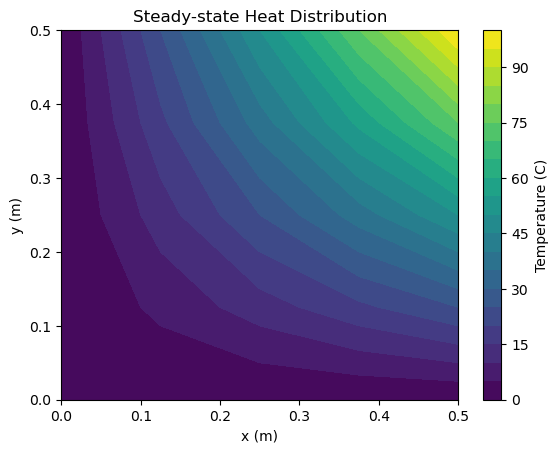

In [8]:
import numpy as np
import scipy.sparse as sp
import scipy.sparse.linalg as splinalg
import matplotlib.pyplot as plt

# 参数定义
n = 4  # 网格的x方向剖分
m = 4  # 网格的y方向剖分
a, b = 0, 0.5  # x方向区间
c, d = 0, 0.5  # y方向区间
h = (b - a) / n  # x方向步长
k = (d - c) / m  # y方向步长

# 创建网格点
x = np.linspace(a, b, n + 1)
y = np.linspace(c, d, m + 1)

# 创建系数矩阵A和右端项向量b
N = (n - 1) * (m - 1)  # 内部网格点数
A = sp.lil_matrix((N, N))  # 系数矩阵，稀疏矩阵格式
B = np.zeros(N)  # 右端项向量

# 构造矩阵
for i in range(1, n):
    for j in range(1, m):
        idx = (i - 1) * (m - 1) + (j - 1)  # 将2D点映射到1D索引
        A[idx, idx] = 4  # 中心点的系数
        if i > 1:
            A[idx, idx - (m - 1)] = -1  # 左邻点
        if i < n - 1:
            A[idx, idx + (m - 1)] = -1  # 右邻点
        if j > 1:
            A[idx, idx - 1] = -1  # 下邻点
        if j < m - 1:
            A[idx, idx + 1] = -1  # 上邻点

        # 设置右端项b (边界条件的影响)
        if i == 1:
            B[idx] += 0  # u(0, y) = 0
        if i == n - 1:
            B[idx] += 200 * y[j]  # u(0.5, y) = 200y
        if j == 1:
            B[idx] += 0  # u(x, 0) = 0
        if j == m - 1:
            B[idx] += 200 * x[i]  # u(x, 0.5) = 200x

# 将A转换为稀疏格式以提高计算效率
A = A.tocsc()

# 使用SciPy求解线性方程组
w = splinalg.spsolve(A, B)

# 将结果重新映射回网格
W = np.zeros((n + 1, m + 1))
W[0, :] = 0  # u(0, y) = 0
W[-1, :] = 200 * y  # u(0.5, y) = 200y
W[:, 0] = 0  # u(x, 0) = 0
W[:, -1] = 200 * x  # u(x, 0.5) = 200x

# 填充内部点的数值解
for i in range(1, n):
    for j in range(1, m):
        idx = (i - 1) * (m - 1) + (j - 1)
        W[i, j] = w[idx]

# 结果可视化
X, Y = np.meshgrid(x, y)
plt.contourf(X, Y, W.T, 20, cmap='viridis')
plt.colorbar(label='Temperature (C)')
plt.title('Steady-state Heat Distribution')
plt.xlabel('x (m)')
plt.ylabel('y (m)')
plt.show()

上面的代码只是数学解题过程的 Python “翻译”，并没有体现出求解问题的通用性. 下面，我们试着重新封装求解过程，定义一个名为 `PoissonSolver` 的求解类. 数值计算工作者只需实例化这个类，调用相应的 API 即可求解.

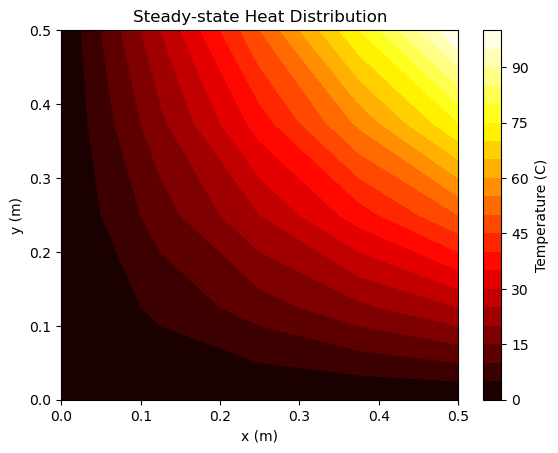

In [9]:
import numpy as np
import scipy.sparse as sp
import scipy.sparse.linalg as splinalg
import matplotlib.pyplot as plt

class PoissonSolver:
    def __init__(self, a, b, c, d, n, m, boundary_conditions):
        """
        初始化 Poisson 方程求解器
        :param a: x方向的左边界
        :param b: x方向的右边界
        :param c: y方向的下边界
        :param d: y方向的上边界
        :param n: x方向网格划分数量
        :param m: y方向网格划分数量
        :param boundary_conditions: 边界条件字典，指定四条边的边界值函数
        """
        self.a, self.b = a, b
        self.c, self.d = c, d
        self.n, self.m = n, m
        self.h = (b - a) / n
        self.k = (d - c) / m
        self.x = np.linspace(a, b, n + 1)
        self.y = np.linspace(c, d, m + 1)
        self.boundary_conditions = boundary_conditions
        self.W = np.zeros((n + 1, m + 1))  # 存储解的网格

    def apply_boundary_conditions(self):
        """
        应用边界条件到网格上
        """
        for i in range(self.n + 1):
            self.W[i, 0] = self.boundary_conditions['bottom'](self.x[i])  # 下边界
            self.W[i, self.m] = self.boundary_conditions['top'](self.x[i])  # 上边界
        for j in range(self.m + 1):
            self.W[0, j] = self.boundary_conditions['left'](self.y[j])  # 左边界
            self.W[self.n, j] = self.boundary_conditions['right'](self.y[j])  # 右边界

    def generate_coefficient_matrix(self):
        """
        生成稀疏系数矩阵和右端项向量
        :return: 系数矩阵A，右端项向量B
        """
        N = (self.n - 1) * (self.m - 1)  # 内部网格点数
        A = sp.lil_matrix((N, N))  # 系数矩阵
        B = np.zeros(N)  # 右端项向量

        for i in range(1, self.n):
            for j in range(1, self.m):
                idx = (i - 1) * (self.m - 1) + (j - 1)  # 将2D点映射到1D索引
                A[idx, idx] = 4  # 中心点的系数
                if i > 1:
                    A[idx, idx - (self.m - 1)] = -1  # 左邻点
                if i < self.n - 1:
                    A[idx, idx + (self.m - 1)] = -1  # 右邻点
                if j > 1:
                    A[idx, idx - 1] = -1  # 下邻点
                if j < self.m - 1:
                    A[idx, idx + 1] = -1  # 上邻点

                # 设置右端项b (边界条件的影响)
                if i == 1:
                    B[idx] += self.boundary_conditions['left'](self.y[j])  # 左边界
                if i == self.n - 1:
                    B[idx] += self.boundary_conditions['right'](self.y[j])  # 右边界
                if j == 1:
                    B[idx] += self.boundary_conditions['bottom'](self.x[i])  # 下边界
                if j == self.m - 1:
                    B[idx] += self.boundary_conditions['top'](self.x[i])  # 上边界

        A = A.tocsc()  # 转换为稀疏矩阵
        return A, B

    def solve(self):
        """
        求解线性方程组，得到内部点的数值解
        """
        self.apply_boundary_conditions()  # 应用边界条件
        A, B = self.generate_coefficient_matrix()  # 生成系数矩阵和右端项
        w = splinalg.spsolve(A, B)  # 求解线性方程组

        # 填充内部点的数值解
        for i in range(1, self.n):
            for j in range(1, self.m):
                idx = (i - 1) * (self.m - 1) + (j - 1)
                self.W[i, j] = w[idx]

    def plot(self):
        """
        可视化解的温度分布
        """
        X, Y = np.meshgrid(self.x, self.y)
        plt.contourf(X, Y, self.W.T, 20, cmap='hot')
        plt.colorbar(label='Temperature (C)')
        plt.title('Steady-state Heat Distribution')
        plt.xlabel('x (m)')
        plt.ylabel('y (m)')
        plt.show()

# 定义边界条件函数
boundary_conditions = {
    'left': lambda y: 0,  # u(0, y) = 0
    'right': lambda y: 200 * y,  # u(0.5, y) = 200y
    'bottom': lambda x: 0,  # u(x, 0) = 0
    'top': lambda x: 200 * x  # u(x, 0.5) = 200x
}

# 创建 Poisson 方程求解器实例
solver = PoissonSolver(a=0, b=0.5, c=0, d=0.5, n=4, m=4, boundary_conditions=boundary_conditions)

# 求解方程并可视化结果
solver.solve()
solver.plot()

再看一个新问题.

> 【例 7.5】
>
> 考虑区域 $\Omega=\{(x,y)|0<x<1, 0<y<1\}$ 内的 Poisson 方程：
> $$\frac{\partial^2 u}{\partial x^2} + \frac{\partial^2 u}{\partial y^2} = -2$$
>
> 带有如下边界条件：
>
> - 在左边界 $x = 0$ 处， $u(0, y) = 0$
> - 在右边界 $x = 1$ 处， $u(1, y) = y^2$
> - 在下边界 $y = 0$ 处， $u(x, 0) = 0$
> - 在上边界 $y = 1$ 处， $u(x, 1) = x^2$
>
> 问题的物理背景可以理解为一个在平面区域上的温度分布，源项函数 $f(x, y) = -2$。求解在该区域内的温度分布.

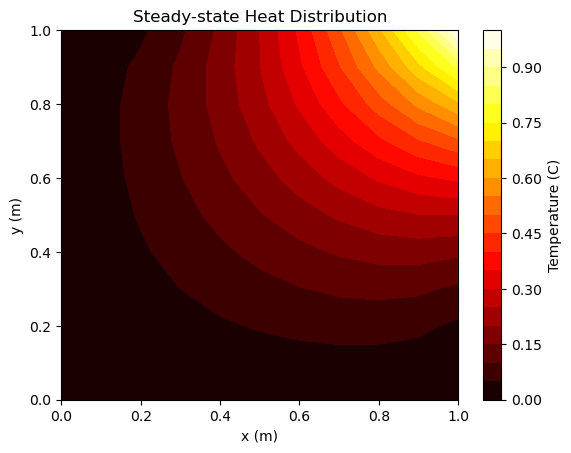

In [10]:
boundary_conditions_new = {
    'left': lambda y: 0,      # u(0, y) = 0
    'right': lambda y: y**2,  # u(1, y) = y^2
    'bottom': lambda x: 0,    # u(x, 0) = 0
    'top': lambda x: x**2     # u(x, 1) = x^2
}

solver_new = PoissonSolver(a=0, b=1, c=0, d=1, n=10, m=10, boundary_conditions=boundary_conditions_new)

solver_new.solve()
solver_new.plot()

#### 抛物型方程

考虑耗散方程 $$\frac{\partial u}{\partial t}(x,t)=\alpha^2\frac{\partial^2 u}{\partial x^2}(x,t),\quad 0<x<l,\quad t>0$$ 满足条件 $$u(0,t)=u(l,t)=0,\quad t>0$$ $$u(x,0)=f(x),\quad 0\le x\le l$$

观察耗散方程可知，$\displaystyle\frac{\partial^2u}{\partial x^2}(x,t)$ 可以用点 $(x_i,t_j)$ 处的中心差分公式近似.

网格点 $(x_i,t_j)$ 定义为 $$x_i=ih,\quad t_j=jk$$ 其中 $h=\displaystyle\frac{l}{m}$，且 $m>0,k>0$.

##### 向前差分法

如果在耗散方程中，左端项使用差商 $$\frac{\partial u}{\partial t}(x_i,t_j)=\frac{u(x_i,t_{j+1})-u(x_i,t_j)}{k}-\frac{k}{2}\frac{\partial^2 u}{\partial t^2}(x_i,\mu_j),\quad \mu_j \in (t_j,t_{j+1})$$ 则抛物型微分方程对每个 $i=1,2,\dots,m-1$和$j=1,2,\dots$ 的内部网格点，有 $$\frac{w_{i,j+1}-w_{i,j}}{k}-\alpha^2\frac{w_{i+1,j}-2w_{i,j}+w_{i-1,j}}{h^2}=0$$ 
其中 $w_{i,j}$ 是 $u(x_i,t_j)$ 的近似. 局部截断误差为 $O(k+h^2)$.

整理离散的耗散方程，令 $\lambda=\displaystyle\frac{\alpha^2k}{h^2}$得

$$w_{i,j+1}=\left(1-2\lambda\right)w_{i,j}+\lambda(w_{i+1,j}+w_{i-1,j}),\quad i=1,2,\dots,m-1,\quad j=1,2,\dots$$

$$w_{0,0}=f(x_0),\quad w_{1,0}=f(x_1),\quad \dots,\quad w_{m,0}=f(x_m)$$

很明显，此方法得到的系数矩阵是一个三对角阵 $${\boldsymbol{A}}=\begin{bmatrix}(1-2\lambda) & \lambda & 0 & \dots & 0 \\ \lambda & (1-2\lambda) & \lambda & \dots & 0 \\ \vdots & \vdots & \vdots & \ddots & \lambda \\ 0 & 0 & 0 & \lambda & (1-2\lambda) \end{bmatrix}$$

又令 ${\boldsymbol{w}}^{(0)}=[f(x_1),f(x_2),\dots,f(x_{m-1})]^\top$ 且对每个 $j=1,2,\dots$ 令 ${\boldsymbol{w}}^{(j)}=[w_{1,j},w_{2,j},\dots,w_{m-1,j}]^\top$ 则近似解可以从下面的**矩阵乘法**迭代得到

$${\boldsymbol{w}}^{(j)}={\boldsymbol{A}}{\boldsymbol{w}}^{(j-1)},\quad j=1,2,\dots$$

这个式子告诉我们，每一次迭代都是从上一个时间步的解，经过**线性变换** (即系数矩阵 $\boldsymbol{A}$ 所代表的变换) 得到的.

##### 向后差分法

求解抛物型方程的向前差分法是**条件稳定**的，即当 $\rho({\boldsymbol{A}}^n)\le 1$ 时，可求得稳定条件为 $0\le \lambda \le 1/2$. 

为了得到**无条件稳定**的方法，考虑用向后差分，即在耗散方程的左端项使用差商 $$\frac{\partial u}{\partial t}(x_i,t_j)=\frac{u(x_i,t_j)-u(x_i,t_{j-1})}{k}-\frac{k}{2}\frac{\partial^2 u}{\partial t^2}(x_i,\mu_j),\quad \mu_j \in (t_{j-1},t_{j})$$ 则抛物型微分方程对每个 $i=1,2,\dots,m-1$和$j=1,2,\dots$ 的内部网格点，有 $$\frac{w_{i,j}-w_{i,j-1}}{k}-\alpha^2\frac{w_{i+1,j}-2w_{i,j}+w_{i-1,j}}{h^2}=0$$ 
其中 $w_{i,j}$ 是 $u(x_i,t_j)$ 的近似. 局部截断误差为 $O(k+h^2)$.

仍然用 $\lambda=\displaystyle\frac{\alpha^2k}{h^2}$，则有 $$(1+2\lambda)w_{i,j}-\lambda w_{i+1,j}-\lambda w_{i-1,j}=w_{i,j-1},\quad i=1,2,\dots,m-1,\quad j=1,2,\dots$$ 写成矩阵代数的形式则是

$${\boldsymbol{A}}{\boldsymbol{w}}^{(j)}={\boldsymbol{w}}^{(j-1)},\quad j=1,2,\dots$$

这个式子告诉我们，当前时间步的解，需要以上一个时间步的解作为线右端项、矩阵 $\boldsymbol{A}$ 为系数矩阵，求解线性方程组得到. 

由于 $\lambda >0$，因此矩阵 $\boldsymbol{A}$ 是严格对角占优的正定矩阵，并且是三对角阵，可以用 Crout 分解或 SOR 算法来求解.

##### Richardson 法

向后差分法的缺点是对空间是 $O(h^2)$ 阶，对时间是 $O(k)$. 这就要求时间间隔要比 $x$ 轴的间隔小得多. 显然，最好能有一个局部截断误差为 $O(k^2+h^2)$ 的算法. 这可以让 $t$ 在点 $(x_i,t_j)$ 对函数 $u(x,t)$ 进行 Taylor 展开，并在 $(x_i,t_{j+1})$ 和 $(x_i,t_{j-1})$ 处求值，得到中心差分公式 $$\frac{\partial u}{\partial t}(x_i,t_j)=\frac{u(x_i,t_{j+1})-u(x_i,t_{j-1})}{2k}+\frac{k^2}{6}\frac{\partial^3 u}{\partial t^3}(x_i,\mu_j),\quad \mu_j \in (t_{j-1},t_{j+1})$$ 采用这种近似的方法叫做 Richardson 法，它在内部网格点上的离散方程是 $$\frac{w_{i,j+1}-w_{i,j-1}}{2k}-\alpha^2\frac{w_{i+1,j}-2w_{i,j}+w_{i-1,j}}{h^2}=0$$ 但是，它有严重的稳定性问题. 

##### Crank-Nicolson 法

分别用关于时间 $t$ 的第 $j$ 步的向前差分和第 $(j+1)$ 步的向后差分，取其平均就得到了 Crank-Nicolson 法 $$\frac{w_{i,j+1}-w_{i,j}}{k}-\frac{\alpha^2}{2}\left(\frac{w_{i+1,j}-2w_{i,j}+w_{i-1,j}}{h^2}+\frac{w_{i+1,j+1}-2w_{i,j+1}+w_{i-1,j+1}}{h^2}\right)=0$$ 这个公式无条件稳定，且具有 $O(k^2+h^2)$ 阶的局部截断误差.

<img src="./assets/comp.png" width="1200" style="display: block;margin-left: auto;margin-right: auto;" />

> 【例 7.6】
>
> 近似求解热传导方程
> $$\frac{\partial u}{\partial t}(x,t)-\frac{\partial^2 u}{\partial x^2}(x,t)=0,\quad 0<x<1,\quad 0\le t$$
> 其中边界条件是
> $$u(0,t)=u(1,t)=0,\quad 0<t$$
> 初始条件是
> $$u(x,0)=\sin(\pi x),\quad 0\le x\le 1$$
> 并比较近似解和在 $t=0.5$ 时候的精确解 $$u(x,t)=e^{-\pi^2t}\sin(\pi x).$$

我们试着使用向前差分法、向后差分法和 Crank-Nicolson 法来求解这个问题. 

假设空间步长是 $h=0.1$，时间步长是 $k=0.0005$.

下面直接演示 Python 编程实现计算.

In [11]:
import numpy as np
import scipy.sparse as sp
import scipy.sparse.linalg as splinalg

class ParabolicSolver:
    def __init__(self, alpha, l, T, m, N, ic, left_bc, right_bc, method='forward'):
        """
        初始化抛物型方程求解器
        :param alpha: 扩散系数
        :param l: 空间区间长度
        :param T: 时间区间长度
        :param m: 空间网格划分数量
        :param N: 时间步数
        :param ic: 初始条件函数 f(x)
        :param left_bc: 左边界条件函数 u(0, t)
        :param right_bc: 右边界条件函数 u(l, t)
        :param method: 求解方法，'forward'（向前差分法）, 'backward'（向后差分法）或 'crank-nicolson'（Crank-Nicolson 法）
        """
        self.alpha = alpha
        self.l = l
        self.T = T
        self.m = m
        self.N = N
        self.h = l / m  # 空间步长
        self.k = T / N  # 时间步长
        self.x = np.linspace(0, l, m + 1)
        self.t = np.arange(0, T + self.k, self.k)
        self.u = np.zeros((m + 1, N + 1))  # 存储数值解
        self.u[:, 0] = f(self.x)  # 初始条件
        self.left_bc = left_bc
        self.right_bc = right_bc
        self.method = method.lower()
        self.lam = (alpha * alpha * self.k) / (self.h * self.h)  # λ = α^2k / h^2
    
    def apply_boundary_conditions(self, j):
        """设置边界条件，更新 j 时刻的左右边界"""
        self.u[0, j] = self.left_bc(self.t[j])   # u(0, t) 的左边界
        self.u[-1, j] = self.right_bc(self.t[j]) # u(l, t) 的右边界
    
    def solve(self):
        """根据选择的方法求解抛物型方程"""
        results = []
        for j in range(1, self.N + 1):
            self.apply_boundary_conditions(j)
            if self.method == 'forward':
                self.forward_method(j)
            elif self.method == 'backward':
                self.backward_method(j)
            elif self.method == 'crank-nicolson':
                self.crank_nicolson_method(j)
            else:
                raise ValueError("未知方法. 请选择 'forward', 'backward', 或 'crank-nicolson'.")
            results.append(self.u[:, j].copy())  # 保存当前时间步的解
        return np.array(results)  # 返回每个时间步的解
    
    def forward_method(self, j):
        """向前差分法求解"""
        A = np.eye(self.m - 1) * (1 - 2 * self.lam) + np.eye(self.m - 1, k=-1) * self.lam + np.eye(self.m - 1, k=1) * self.lam
        self.u[1:self.m, j] = A @ self.u[1:self.m, j - 1]
    
    def backward_method(self, j):
        """向后差分法求解"""
        A = np.eye(self.m - 1) * (1 + 2 * self.lam) - np.eye(self.m - 1, k=-1) * self.lam - np.eye(self.m - 1, k=1) * self.lam
        A_sparse = sp.csc_matrix(A)
        b = self.u[1:self.m, j - 1]
        self.u[1:self.m, j] = splinalg.spsolve(A_sparse, b)
    
    def crank_nicolson_method(self, j):
        """Crank-Nicolson 法求解"""
        A = np.eye(self.m - 1) * (1 + self.lam) - np.eye(self.m - 1, k=-1) * (self.lam / 2) - np.eye(self.m - 1, k=1) * (self.lam / 2)
        B = np.eye(self.m - 1) * (1 - self.lam) + np.eye(self.m - 1, k=-1) * (self.lam / 2) + np.eye(self.m - 1, k=1) * (self.lam / 2)
        A_sparse = sp.csc_matrix(A)
        b = B @ self.u[1:self.m, j - 1]
        self.u[1:self.m, j] = splinalg.spsolve(A_sparse, b)


Animation size has reached 20979940 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


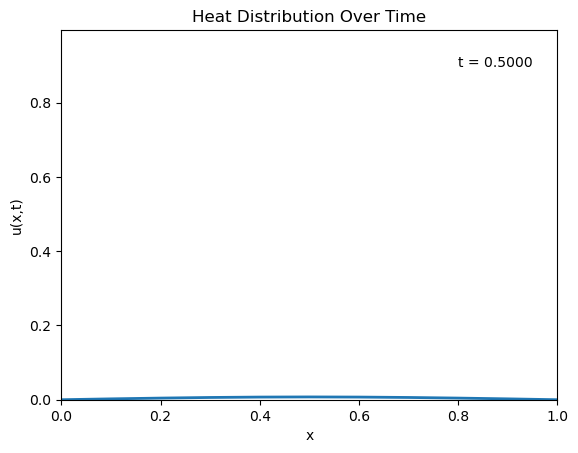

In [12]:
from IPython.display import HTML
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# 定义定解条件
f = lambda x: np.sin(np.pi * x)  # 初始条件 u(x, 0) = sin(pi x)
left_bc = lambda t: 0  # 左边界条件 u(0, t) = 0
right_bc = lambda t: 0  # 右边界条件 u(1, t) = 0

solver = ParabolicSolver(alpha=1, l=1, T=0.5, m=10, N=1000, ic=f, left_bc=left_bc, right_bc=right_bc, method='crank-nicolson')
results = solver.solve()

# 使用matplotlib动画进行展示
fig, ax = plt.subplots()
line, = ax.plot(solver.x, results[0], lw=2)
ax.set_xlim(0, solver.l)
ax.set_ylim(np.min(results), np.max(results))
ax.set_xlabel('x')
ax.set_ylabel('u(x,t)')
ax.set_title('Heat Distribution Over Time')

time_text = ax.text(0.8, 0.9, '', transform=ax.transAxes)

def update(frame):
    line.set_ydata(results[frame])
    time_text.set_text(f't = {solver.t[frame + 1]:.4f}')  # 更新当前的时间显示（从 t[1] 开始）
    return line, time_text

ani = FuncAnimation(fig, update, frames=len(results), blit=True)

# 使用HTML工具来显示动画
HTML(ani.to_jshtml())

In [13]:
# 保存动画到本地文件
ani.save('results/heat_distribution.mp4', writer='ffmpeg')

# 在 Jupyter 中显示文件链接
from IPython.display import Video
Video('results/heat_distribution.mp4')

#### 双曲型方程

考虑波动方程 $$\frac{\partial^2 u}{\partial t^2}(x,t)-\alpha^2\frac{\partial^2 u}{\partial x^2}(x,t)=0,\quad 0<x<l,\quad t>0$$ 满足条件 $$u(0,t)=u(l,t)=0,\quad t>0$$ $$u(x,0)=f(x),\quad \frac{\partial u}{\partial t}(x,0)=g(x),\quad 0\le x\le l$$
网格点 $(x_i,t_j)$ 定义为 $$x_i=ih,\quad t_j=jk$$ 其中 $h=\displaystyle\frac{l}{m}$，且 $m>0,k>0$.

对变量 $x$ 和 $t$ 均采用中心差分近似，略去误差项，得到 $$\frac{w_{i,j+1}-2w_{i,j}+w_{i,j-1}}{k^2}-\alpha^2\frac{w_{i+1,j}-2w_{i,j}+w_{i-1,j}}{h^2}=0$$ 令 $\lambda=\displaystyle\frac{\alpha k}{h}$，则差分方程可以整理为 $$w_{i,j+1}=2(1-\lambda^2)w_{i,j}+\lambda^2(w_{i+1,j}+w_{i-1,j})-w_{i,j-1},\quad i=1,2,\dots,m-1,\quad j=1,2,\dots$$ 其中边界条件是 $$w_{0,j}=w_{m,j}=0,\quad j=1,2,\dots$$ $j=0$ 时的初始条件是 $$w_{i,0}=f(x_i),\quad i=1,2,\dots,m-1$$ 要得到第 $(j+1)$ 个时间步，需要用到前两步，即第 $j$ 和 $(j-1)$ 个时间步上的值.

对于 $j=1$ 时的值，需要从初始速度条件中得到. 一种方法是对速度条件使用向前差分，略去误差项，得 $$\frac{\partial u}{\partial t}(x_i,0)=\frac{u(x_i,t_1)-u(x_i,0)}{k}=g(x_i)$$ 整理得到 $$w_{i,1}=w_{i,0}+kg(x_i),\quad i=1,2,\dots,m-1$$ 但这个方法的截断误差阶是 $O(k)$. 

#### 有限元法

在求解 PDE 的方法中，有限差分法基于应用局部 Taylor 展开来近似微分方程. 它使用拓扑学上的方格网络来构建 PDE 的离散化. 但是，它不适用于处理复杂的多维几何形状. 这个问题促使人们使用 PDE 的积分形式，并随后发展了**有限单元法** (finite element method)，或简称**有限元法**.

有限元法类似于 Rayleigh-Ritz 法. 与有限差分法相比，有限元法的优势之一是可以很容易地处理问题的边界条件. 许多问题的边界条件涉及导数和不规则形状的边界，很难用有限差分处理，因为每个涉及导数的边界条件必须用网格点的差商来近似，而边界的不规则形状使得网格点的放置困难. 有限元法将边界条件作为被最小化的**泛函** (functional) 中的积分，因此其构造过程与问题的特定边界条件无关.
